In [1]:
from datasets import Dataset, DatasetDict, Image
import os
import random

# Define
dataset_name = "PKLOT" # ACPDS | PKLOT
train_ratio = 0.6
test_ratio = 0.3

d:\MS\CS 6384.001 - Computer Vision - S25\Parking-Space-Detection\.venv\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
dataset_root = f"./data/{dataset_name}/{dataset_name}"
image_dir = os.path.join(dataset_root, "images")
mask_dir = os.path.join(dataset_root, "int_masks")

image_paths = sorted([
    os.path.join(image_dir, f)
    for f in os.listdir(image_dir)
    if f.endswith(".jpg")
])

label_paths = sorted([
    os.path.join(mask_dir, f.replace(".jpg", ".png"))
    for f in os.listdir(image_dir)
    if f.endswith(".jpg")
])

# Shuffle together to preserve mapping
combined = list(zip(image_paths, label_paths))
random.seed(42)  # for reproducibility
random.shuffle(combined)

train_size = int(len(combined)*train_ratio)
test_size = int(len(combined)*test_ratio)
val_size = len(combined) - train_size - test_size

train_split = combined[:train_size]
test_split = combined[train_size:train_size + test_size]
val_split = combined[train_size + test_size:]

# Unzip back
train_imgs, train_masks = zip(*train_split)
test_imgs, test_masks = zip(*test_split)
val_imgs, val_masks = zip(*val_split)

def create_dataset(image_paths, label_paths):
    dataset = Dataset.from_dict({
        "image": image_paths,
        "label": label_paths
    })
    dataset = dataset.cast_column("image", Image())
    dataset = dataset.cast_column("label", Image())
    return dataset

dataset = DatasetDict({
    "train": create_dataset(train_imgs, train_masks),
    "test": create_dataset(test_imgs, test_masks),
    "validation": create_dataset(val_imgs, val_masks)
})

dataset

DatasetDict({
    train: Dataset({
        features: ['image', 'label'],
        num_rows: 7449
    })
    test: Dataset({
        features: ['image', 'label'],
        num_rows: 3724
    })
    validation: Dataset({
        features: ['image', 'label'],
        num_rows: 1243
    })
})

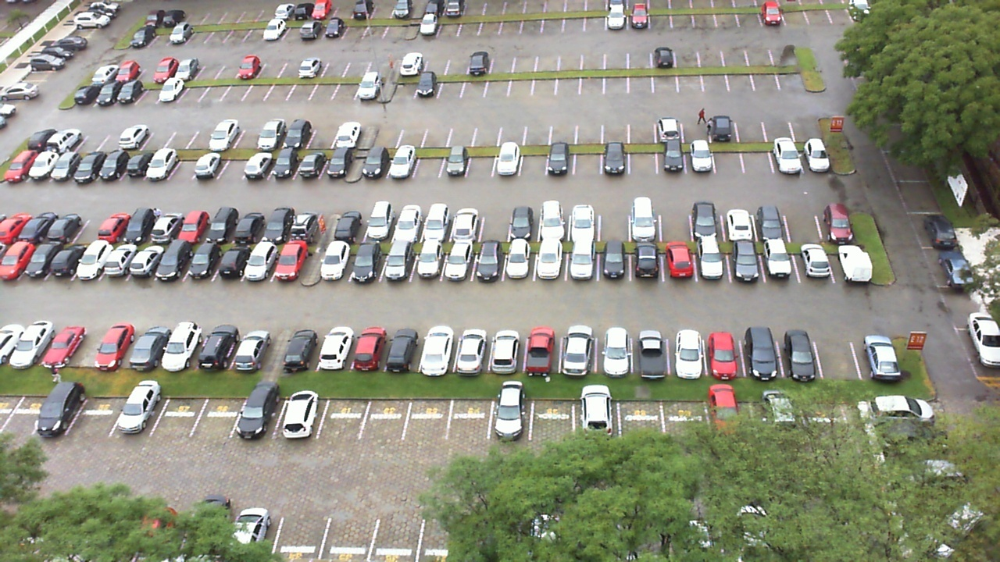

In [3]:
example = dataset["train"][0]
image = example["image"]
image

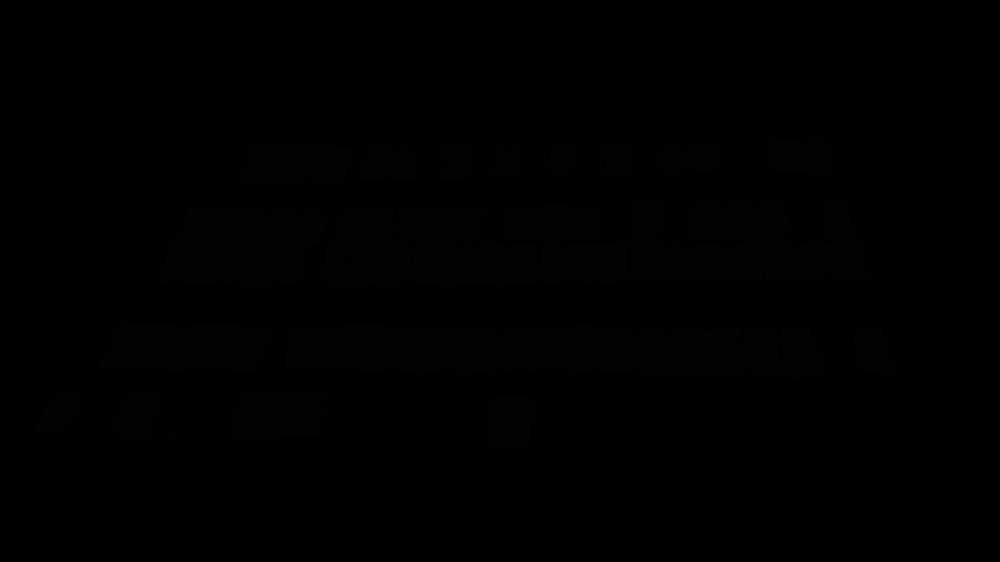

In [4]:
segmentation_map = example["label"]
segmentation_map

In [5]:
import numpy as np

segmentation_map = np.array(segmentation_map)
segmentation_map

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], shape=(720, 1280), dtype=uint8)

In [6]:
id2label = {
    0: "background",
    1: "free",
    2: "occupied"
}
print(id2label)

{0: 'background', 1: 'free', 2: 'occupied'}


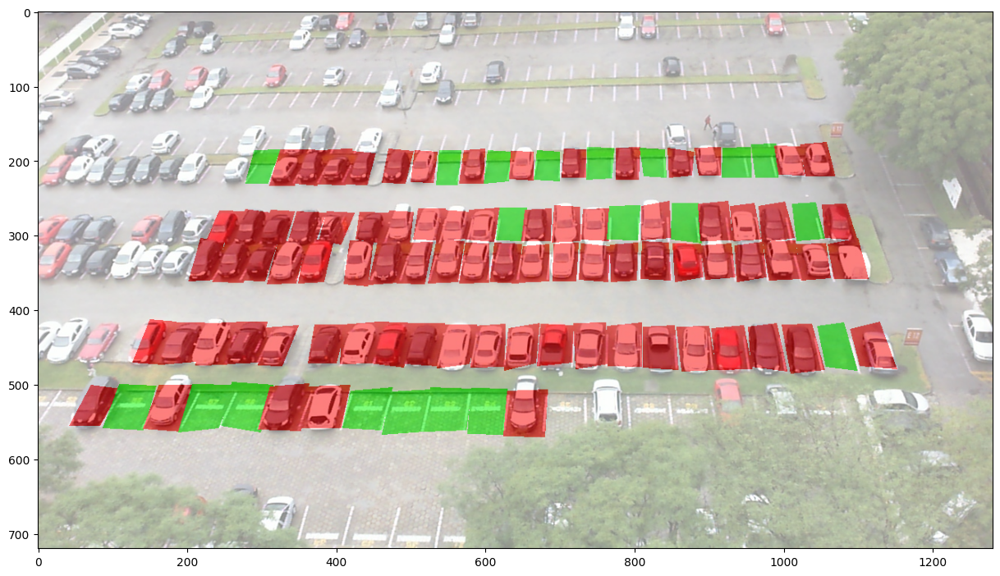

In [7]:
import numpy as np
import matplotlib.pyplot as plt

id2color = {
    0: (255,255,255),
    1: (0,255,0),
    2: (255,0,0)
}

def visualize_map(image, segmentation_map):
    color_seg = np.zeros((segmentation_map.shape[0], segmentation_map.shape[1], 3), dtype=np.uint8) # height, width, 3
    for label, color in id2color.items():
        color_seg[segmentation_map == label, :] = color

    # Show image + mask
    img = np.array(image) * 0.5 + color_seg * 0.5
    img = img.astype(np.uint8)

    plt.figure(figsize=(15, 10))
    plt.imshow(img)
    plt.show()

visualize_map(image, segmentation_map)

In [8]:
from torch.utils.data import Dataset
import torch
import numpy as np
from torchvision import transforms
import torchvision.transforms.functional as VF
from torchvision.transforms import InterpolationMode

ADE_MEAN = np.array([123.675, 116.280, 103.530]) / 255
ADE_STD = np.array([58.395, 57.120, 57.375]) / 255

class SegmentationDataset(Dataset):
    def __init__(self, dataset, resize_size=(448, 448)):
        self.dataset = dataset
        self.resize_size = resize_size
        self.normalize = transforms.Normalize(mean=ADE_MEAN, std=ADE_STD)

    def __len__(self):
        return len(self.dataset)

    def __getitem__(self, idx):
        item = self.dataset[idx]
        og_image = np.array(item["image"])
        og_mask = np.array(item["label"])

        # Convert image to tensor
        image = VF.to_tensor(og_image)  # [C, H, W], scaled to [0, 1]
        mask = torch.from_numpy(og_mask).long()  # [H, W] with class IDs

        # Resize
        image = VF.resize(image, self.resize_size, interpolation=InterpolationMode.BILINEAR)
        mask = VF.resize(mask.unsqueeze(0), self.resize_size, interpolation=InterpolationMode.NEAREST).squeeze(0)

        # Normalize
        image = self.normalize(image)

        return image, mask, og_image, og_mask

In [9]:
train_dataset = SegmentationDataset(dataset["train"])
val_dataset = SegmentationDataset(dataset["validation"])
test_dataset = SegmentationDataset(dataset["test"])

In [10]:
pixel_values, target, original_image, original_segmentation_map = train_dataset[3]
print(pixel_values.shape)
print(target.shape)

torch.Size([3, 448, 448])
torch.Size([448, 448])


In [11]:
pixel_values_val, target_val, original_image_val, original_segmentation_map_val = val_dataset[3]
print(pixel_values_val.shape)
print(target_val.shape)

torch.Size([3, 448, 448])
torch.Size([448, 448])


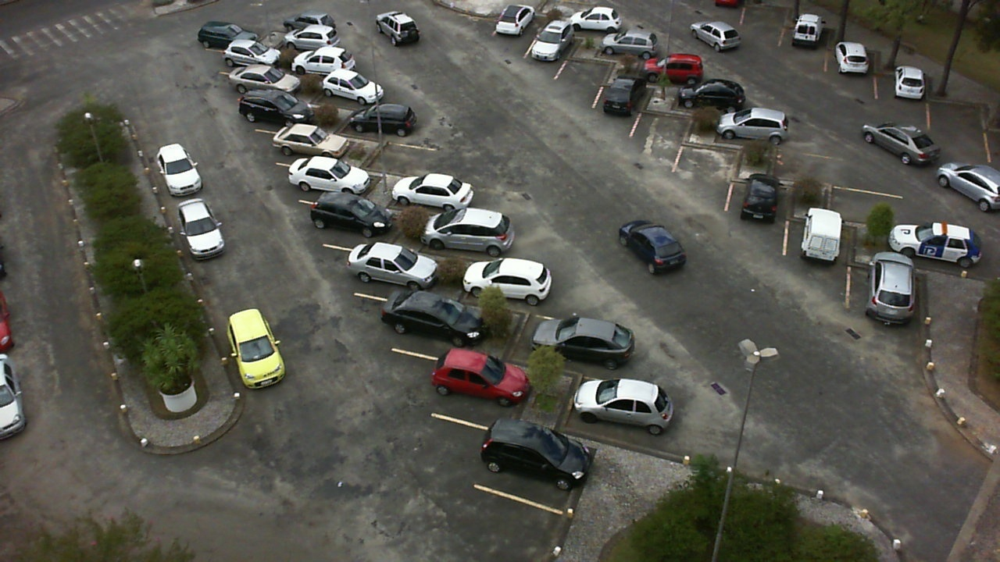

In [12]:
from PIL import Image

Image.fromarray(original_image)

In [13]:
[id2label[id] for id in np.unique(original_segmentation_map).tolist()]

['background', 'free', 'occupied']

In [14]:
from torch.utils.data import DataLoader

def collate_fn(inputs):
    batch = dict()
    batch["pixel_values"] = torch.stack([i[0] for i in inputs], dim=0)
    batch["labels"] = torch.stack([i[1] for i in inputs], dim=0)
    batch["original_images"] = [i[2] for i in inputs]
    batch["original_segmentation_maps"] = [i[3] for i in inputs]

    return batch

from torch.utils.data import DataLoader

def collate_fn(inputs):
    batch = dict()
    batch["pixel_values"] = torch.stack([i[0] for i in inputs], dim=0)
    batch["labels"] = torch.stack([i[1] for i in inputs], dim=0)
    batch["original_images"] = [i[2] for i in inputs]
    batch["original_segmentation_maps"] = [i[3] for i in inputs]

    return batch

train_dataloader = DataLoader(train_dataset, batch_size=3, shuffle=True, collate_fn=collate_fn)
val_dataloader = DataLoader(val_dataset, batch_size=3, shuffle=False, collate_fn=collate_fn)
test_dataloader = DataLoader(test_dataset, batch_size=3, shuffle=True, collate_fn=collate_fn)

In [15]:
batch = next(iter(train_dataloader))
for k,v in batch.items():
  if isinstance(v,torch.Tensor):
    print(k,v.shape)

pixel_values torch.Size([3, 3, 448, 448])
labels torch.Size([3, 448, 448])


In [16]:
batch["pixel_values"].dtype

torch.float32

In [17]:
batch["labels"].dtype

torch.int64

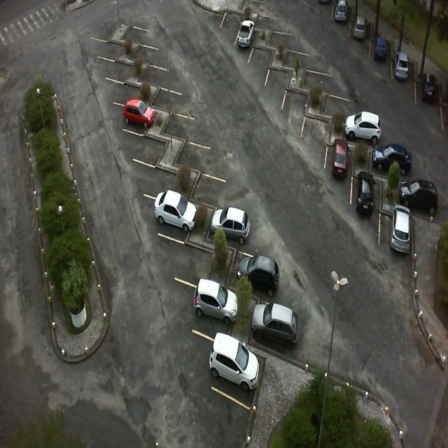

In [18]:
from PIL import Image

unnormalized_image = (batch["pixel_values"][0].numpy() * np.array(ADE_STD)[:, None, None]) + np.array(ADE_MEAN)[:, None, None]
unnormalized_image = (unnormalized_image * 255).astype(np.uint8)
unnormalized_image = np.moveaxis(unnormalized_image, 0, -1)
unnormalized_image = Image.fromarray(unnormalized_image)
unnormalized_image

In [19]:
[id2label[id] for id in torch.unique(batch["labels"][0]).tolist()]

['background', 'free', 'occupied']

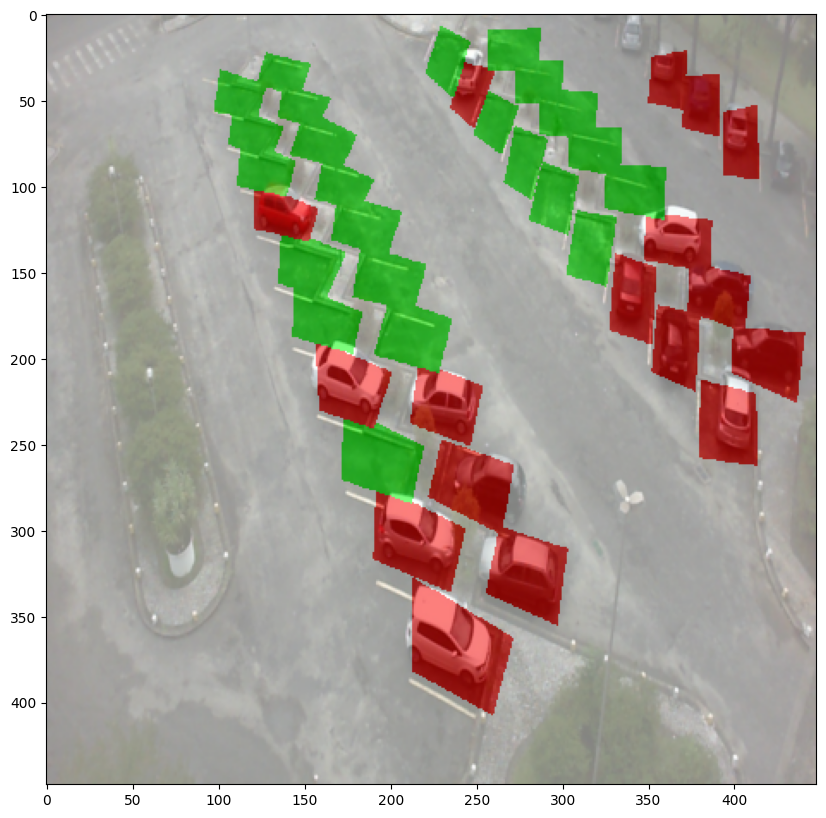

In [20]:
visualize_map(unnormalized_image, batch["labels"][0].numpy())

In [21]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from transformers import Dinov2Model, Dinov2PreTrainedModel
from transformers.modeling_outputs import SemanticSegmenterOutput

# Simplified SegFormer-style Head
class SegFormerHead(nn.Module):
    def __init__(self, in_channels, hidden_size, num_classes):
        super().__init__()
        self.linear = nn.Sequential(
            nn.Conv2d(in_channels, hidden_size, kernel_size=1),
            nn.ReLU(),
            nn.BatchNorm2d(hidden_size)
        )
        self.dropout = nn.Dropout(0.1)
        self.classifier = nn.Conv2d(hidden_size, num_classes, kernel_size=1)

    def forward(self, x, height, width):
        B, N, C = x.shape
        h = w = int(N ** 0.5)
        x = x.view(B, h, w, C).permute(0, 3, 1, 2)  # [B, C, H, W]
        x = self.linear(x)                          # [B, hidden_size, H, W]
        x = self.dropout(x)
        x = self.classifier(x)                      # [B, num_classes, H, W]
        x = F.interpolate(x, size=(height, width), mode="bilinear", align_corners=False)
        return x

# Your main segmentation model using Dinov2 + custom head
class Dinov2ForSemanticSegmentation(Dinov2PreTrainedModel):
    def __init__(self, config):
        super().__init__(config)
        self.dinov2 = Dinov2Model(config)
        self.classifier = SegFormerHead(
            in_channels=config.hidden_size,
            hidden_size=256,
            num_classes=config.num_labels
        )

    def forward(self, pixel_values, output_hidden_states=False, output_attentions=False, labels=None):
        outputs = self.dinov2(pixel_values,
                              output_hidden_states=output_hidden_states,
                              output_attentions=output_attentions)

        # Drop CLS token
        patch_embeddings = outputs.last_hidden_state[:, 1:, :]  # [B, N-1, C]

        # Classifier head
        logits = self.classifier(
            patch_embeddings,
            height=pixel_values.shape[2],
            width=pixel_values.shape[3]
        )

        loss = None
        if labels is not None:
            loss_fct = nn.CrossEntropyLoss(ignore_index=0)
            loss = loss_fct(logits, labels)

        return SemanticSegmenterOutput(
            loss=loss,
            logits=logits,
            hidden_states=outputs.hidden_states,
            attentions=outputs.attentions,
        )


In [22]:
model = Dinov2ForSemanticSegmentation.from_pretrained("facebook/dinov2-base", id2label=id2label, num_labels=len(id2label))

Some weights of Dinov2ForSemanticSegmentation were not initialized from the model checkpoint at facebook/dinov2-base and are newly initialized: ['classifier.classifier.bias', 'classifier.classifier.weight', 'classifier.linear.0.bias', 'classifier.linear.0.weight', 'classifier.linear.2.bias', 'classifier.linear.2.num_batches_tracked', 'classifier.linear.2.running_mean', 'classifier.linear.2.running_var', 'classifier.linear.2.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [23]:
# Freeze dinov2
for name, param in model.named_parameters():
  if name.startswith("dinov2"):
    param.requires_grad = False

In [24]:
outputs = model(pixel_values=batch["pixel_values"], labels=batch["labels"])
print(outputs.logits.shape)
print(outputs.loss)

torch.Size([3, 3, 448, 448])
tensor(4.7048, grad_fn=<NllLoss2DBackward0>)


In [25]:
import evaluate
metric = evaluate.load("mean_iou")

In [26]:
from torch.optim import AdamW
from tqdm.auto import tqdm
from transformers import get_scheduler
from torchmetrics.classification import MulticlassF1Score, MulticlassRecall, MulticlassPrecision
from torchmetrics import MeanMetric
from torchmetrics import Accuracy, JaccardIndex
import torch

# === Hyperparameters ===
learning_rate = 1e-3
epochs = 10
num_classes = len(id2label)  # e.g., 3: background, free, occupied

# === Move model to GPU ===
device = torch.device("cuda")
model.to(device)

# === Optimizer & Scheduler ===
optimizer = AdamW(model.parameters(), lr=learning_rate)
num_training_steps = len(train_dataloader) * epochs

lr_scheduler = get_scheduler(
    "linear",
    optimizer=optimizer,
    num_warmup_steps=int(0.1 * num_training_steps),
    num_training_steps=num_training_steps
)

# === Define Metrics (excluding background / class 0) ===
f1_metric = MulticlassF1Score(num_classes=num_classes, average='macro', ignore_index=0).to(device)
recall_metric = MulticlassRecall(num_classes=num_classes, average='macro', ignore_index=0).to(device)
precision_metric = MulticlassPrecision(num_classes=num_classes, average='macro', ignore_index=0).to(device)
mean_iou_metric = JaccardIndex(task="multiclass", num_classes=num_classes, ignore_index=0).to(device)
accuracy_metric = Accuracy(task="multiclass", num_classes=num_classes, ignore_index=0).to(device)
loss_metric = MeanMetric().to(device)

# === Training Loop ===
model.train()
for epoch in range(epochs):
    print(f"\nEpoch {epoch+1}/{epochs}")

    # Reset all metrics per epoch
    f1_metric.reset()
    recall_metric.reset()
    precision_metric.reset()
    mean_iou_metric.reset()
    accuracy_metric.reset()
    loss_metric.reset()

    for idx, batch in enumerate(tqdm(train_dataloader, desc="Training")):
        pixel_values = batch["pixel_values"].to(device)
        labels = batch["labels"].to(device)

        # Forward pass
        outputs = model(pixel_values, labels=labels)
        loss = outputs.loss
        logits = outputs.logits
        predicted = logits.argmax(dim=1)

        # Backward
        loss.backward()
        optimizer.step()
        lr_scheduler.step()
        optimizer.zero_grad()

        # Update metrics
        with torch.no_grad():
            f1_metric.update(predicted, labels)
            recall_metric.update(predicted, labels)
            precision_metric.update(predicted, labels)
            mean_iou_metric.update(predicted, labels)
            accuracy_metric.update(predicted, labels)
            loss_metric.update(loss)

        # Intermediate print every 100 steps
        if idx % 100 == 0:
            f1 = f1_metric.compute()
            recall = recall_metric.compute()
            precision = precision_metric.compute()
            mean_iou = mean_iou_metric.compute()
            mean_accuracy = accuracy_metric.compute()
            avg_loss = loss_metric.compute()

            print(f"[Batch {idx}]")
            print(f"Loss: {avg_loss:.4f} | Mean IoU: {mean_iou:.4f} | Mean Acc: {mean_accuracy:.4f}")
            print(f"F1 Score: {f1:.4f} | Recall: {recall:.4f} | Precision: {precision:.4f}")

    # Final epoch metrics
    f1 = f1_metric.compute()
    recall = recall_metric.compute()
    precision = precision_metric.compute()
    mean_iou = mean_iou_metric.compute()
    mean_accuracy = accuracy_metric.compute()
    avg_loss = loss_metric.compute()

    print(f"\n[Epoch {epoch+1} Summary]")
    print(f"Loss: {avg_loss:.4f}")
    print(f"Mean IoU: {mean_iou:.4f} | Mean Accuracy: {mean_accuracy:.4f}")
    print(f"F1 Score: {f1:.4f} | Recall: {recall:.4f} | Precision: {precision:.4f}")



Epoch 1/10


Training:   0%|          | 1/2483 [00:00<41:19,  1.00it/s]

[Batch 0]
Loss: 8.5258 | Mean IoU: 0.1530 | Mean Acc: 0.3050
F1 Score: 0.1562 | Recall: 0.1065 | Precision: 0.2928


Training:   4%|▍         | 101/2483 [00:31<11:50,  3.35it/s]

[Batch 100]
Loss: 4.3585 | Mean IoU: 0.1561 | Mean Acc: 0.2559
F1 Score: 0.1713 | Recall: 0.1664 | Precision: 0.3479


Training:   8%|▊         | 201/2483 [01:01<11:25,  3.33it/s]

[Batch 200]
Loss: 2.8939 | Mean IoU: 0.2712 | Mean Acc: 0.3726
F1 Score: 0.2795 | Recall: 0.2494 | Precision: 0.3229


Training:  12%|█▏        | 301/2483 [01:31<10:52,  3.35it/s]

[Batch 300]
Loss: 2.1763 | Mean IoU: 0.3938 | Mean Acc: 0.5146
F1 Score: 0.3733 | Recall: 0.3429 | Precision: 0.4165


Training:  16%|█▌        | 401/2483 [02:03<11:32,  3.01it/s]

[Batch 400]
Loss: 1.7429 | Mean IoU: 0.4911 | Mean Acc: 0.6121
F1 Score: 0.4375 | Recall: 0.4086 | Precision: 0.4761


Training:  20%|██        | 501/2483 [02:42<13:40,  2.42it/s]

[Batch 500]
Loss: 1.4496 | Mean IoU: 0.5561 | Mean Acc: 0.6736
F1 Score: 0.4753 | Recall: 0.4490 | Precision: 0.5093


Training:  24%|██▍       | 601/2483 [03:20<11:14,  2.79it/s]

[Batch 600]
Loss: 1.2478 | Mean IoU: 0.6017 | Mean Acc: 0.7151
F1 Score: 0.5000 | Recall: 0.4763 | Precision: 0.5297


Training:  28%|██▊       | 701/2483 [03:59<10:43,  2.77it/s]

[Batch 700]
Loss: 1.0960 | Mean IoU: 0.6388 | Mean Acc: 0.7471
F1 Score: 0.5191 | Recall: 0.4977 | Precision: 0.5454


Training:  32%|███▏      | 801/2483 [04:34<09:54,  2.83it/s]

[Batch 800]
Loss: 0.9792 | Mean IoU: 0.6695 | Mean Acc: 0.7728
F1 Score: 0.5342 | Recall: 0.5147 | Precision: 0.5577


Training:  36%|███▋      | 901/2483 [05:12<09:54,  2.66it/s]

[Batch 900]
Loss: 0.8907 | Mean IoU: 0.6914 | Mean Acc: 0.7911
F1 Score: 0.5446 | Recall: 0.5266 | Precision: 0.5659


Training:  40%|████      | 1001/2483 [05:50<09:39,  2.56it/s]

[Batch 1000]
Loss: 0.8195 | Mean IoU: 0.7094 | Mean Acc: 0.8060
F1 Score: 0.5530 | Recall: 0.5364 | Precision: 0.5725


Training:  44%|████▍     | 1101/2483 [06:28<08:31,  2.70it/s]

[Batch 1100]
Loss: 0.7571 | Mean IoU: 0.7260 | Mean Acc: 0.8190
F1 Score: 0.5606 | Recall: 0.5453 | Precision: 0.5784


Training:  48%|████▊     | 1201/2483 [07:05<07:45,  2.75it/s]

[Batch 1200]
Loss: 0.7039 | Mean IoU: 0.7409 | Mean Acc: 0.8305
F1 Score: 0.5672 | Recall: 0.5529 | Precision: 0.5838


Training:  52%|█████▏    | 1301/2483 [07:41<06:56,  2.84it/s]

[Batch 1300]
Loss: 0.6640 | Mean IoU: 0.7504 | Mean Acc: 0.8383
F1 Score: 0.5714 | Recall: 0.5580 | Precision: 0.5869


Training:  56%|█████▋    | 1401/2483 [08:17<06:19,  2.85it/s]

[Batch 1400]
Loss: 0.6285 | Mean IoU: 0.7596 | Mean Acc: 0.8454
F1 Score: 0.5754 | Recall: 0.5629 | Precision: 0.5898


Training:  60%|██████    | 1501/2483 [08:54<05:52,  2.78it/s]

[Batch 1500]
Loss: 0.5991 | Mean IoU: 0.7670 | Mean Acc: 0.8513
F1 Score: 0.5786 | Recall: 0.5668 | Precision: 0.5922


Training:  64%|██████▍   | 1601/2483 [09:30<05:16,  2.78it/s]

[Batch 1600]
Loss: 0.5724 | Mean IoU: 0.7730 | Mean Acc: 0.8562
F1 Score: 0.5811 | Recall: 0.5700 | Precision: 0.5941


Training:  69%|██████▊   | 1701/2483 [10:06<04:41,  2.78it/s]

[Batch 1700]
Loss: 0.5463 | Mean IoU: 0.7802 | Mean Acc: 0.8615
F1 Score: 0.5842 | Recall: 0.5736 | Precision: 0.5964


Training:  73%|███████▎  | 1801/2483 [10:42<04:06,  2.76it/s]

[Batch 1800]
Loss: 0.5241 | Mean IoU: 0.7863 | Mean Acc: 0.8662
F1 Score: 0.5868 | Recall: 0.5767 | Precision: 0.5984


Training:  77%|███████▋  | 1901/2483 [11:18<03:29,  2.78it/s]

[Batch 1900]
Loss: 0.5040 | Mean IoU: 0.7923 | Mean Acc: 0.8706
F1 Score: 0.5893 | Recall: 0.5797 | Precision: 0.6003


Training:  81%|████████  | 2001/2483 [11:55<02:52,  2.79it/s]

[Batch 2000]
Loss: 0.4875 | Mean IoU: 0.7955 | Mean Acc: 0.8731
F1 Score: 0.5907 | Recall: 0.5816 | Precision: 0.6011


Training:  85%|████████▍ | 2101/2483 [12:31<02:15,  2.82it/s]

[Batch 2100]
Loss: 0.4717 | Mean IoU: 0.7991 | Mean Acc: 0.8759
F1 Score: 0.5921 | Recall: 0.5835 | Precision: 0.6021


Training:  89%|████████▊ | 2201/2483 [13:08<01:38,  2.85it/s]

[Batch 2200]
Loss: 0.4581 | Mean IoU: 0.8024 | Mean Acc: 0.8784
F1 Score: 0.5935 | Recall: 0.5853 | Precision: 0.6030


Training:  93%|█████████▎| 2301/2483 [13:44<01:05,  2.80it/s]

[Batch 2300]
Loss: 0.4449 | Mean IoU: 0.8062 | Mean Acc: 0.8812
F1 Score: 0.5951 | Recall: 0.5872 | Precision: 0.6042


Training:  97%|█████████▋| 2401/2483 [14:20<00:29,  2.76it/s]

[Batch 2400]
Loss: 0.4329 | Mean IoU: 0.8096 | Mean Acc: 0.8837
F1 Score: 0.5964 | Recall: 0.5889 | Precision: 0.6052


Training: 100%|██████████| 2483/2483 [14:50<00:00,  2.79it/s]



[Epoch 1 Summary]
Loss: 0.4226
Mean IoU: 0.8129 | Mean Accuracy: 0.8862
F1 Score: 0.5978 | Recall: 0.5904 | Precision: 0.6063

Epoch 2/10


Training:   0%|          | 1/2483 [00:00<13:25,  3.08it/s]

[Batch 0]
Loss: 0.1130 | Mean IoU: 0.9136 | Mean Acc: 0.9585
F1 Score: 0.9547 | Recall: 0.9520 | Precision: 0.9575


Training:   4%|▍         | 101/2483 [00:30<11:58,  3.32it/s]

[Batch 100]
Loss: 0.1211 | Mean IoU: 0.9153 | Mean Acc: 0.9559
F1 Score: 0.9558 | Recall: 0.9551 | Precision: 0.9570


Training:   8%|▊         | 201/2483 [01:01<11:22,  3.34it/s]

[Batch 200]
Loss: 0.1275 | Mean IoU: 0.9033 | Mean Acc: 0.9495
F1 Score: 0.6328 | Recall: 0.6321 | Precision: 0.6339


Training:  12%|█▏        | 301/2483 [01:31<10:55,  3.33it/s]

[Batch 300]
Loss: 0.1247 | Mean IoU: 0.9076 | Mean Acc: 0.9517
F1 Score: 0.6344 | Recall: 0.6341 | Precision: 0.6350


Training:  16%|█▌        | 401/2483 [02:02<10:26,  3.32it/s]

[Batch 400]
Loss: 0.1267 | Mean IoU: 0.9045 | Mean Acc: 0.9499
F1 Score: 0.6332 | Recall: 0.6329 | Precision: 0.6339


Training:  20%|██        | 501/2483 [02:32<09:56,  3.32it/s]

[Batch 500]
Loss: 0.1317 | Mean IoU: 0.8990 | Mean Acc: 0.9469
F1 Score: 0.6312 | Recall: 0.6310 | Precision: 0.6318


Training:  24%|██▍       | 601/2483 [03:03<09:29,  3.31it/s]

[Batch 600]
Loss: 0.1291 | Mean IoU: 0.9018 | Mean Acc: 0.9484
F1 Score: 0.6322 | Recall: 0.6321 | Precision: 0.6328


Training:  28%|██▊       | 701/2483 [03:34<09:39,  3.07it/s]

[Batch 700]
Loss: 0.1280 | Mean IoU: 0.9034 | Mean Acc: 0.9493
F1 Score: 0.6328 | Recall: 0.6326 | Precision: 0.6334


Training:  32%|███▏      | 801/2483 [04:06<09:31,  2.94it/s]

[Batch 800]
Loss: 0.1323 | Mean IoU: 0.8998 | Mean Acc: 0.9474
F1 Score: 0.6315 | Recall: 0.6312 | Precision: 0.6323


Training:  36%|███▋      | 901/2483 [04:37<08:00,  3.29it/s]

[Batch 900]
Loss: 0.1309 | Mean IoU: 0.9010 | Mean Acc: 0.9480
F1 Score: 0.6320 | Recall: 0.6318 | Precision: 0.6326


Training:  40%|████      | 1001/2483 [05:09<07:28,  3.31it/s]

[Batch 1000]
Loss: 0.1297 | Mean IoU: 0.9022 | Mean Acc: 0.9487
F1 Score: 0.6324 | Recall: 0.6321 | Precision: 0.6330


Training:  44%|████▍     | 1101/2483 [05:40<07:34,  3.04it/s]

[Batch 1100]
Loss: 0.1277 | Mean IoU: 0.9035 | Mean Acc: 0.9494
F1 Score: 0.6329 | Recall: 0.6327 | Precision: 0.6335


Training:  48%|████▊     | 1201/2483 [06:12<06:39,  3.21it/s]

[Batch 1200]
Loss: 0.1252 | Mean IoU: 0.9054 | Mean Acc: 0.9505
F1 Score: 0.6336 | Recall: 0.6333 | Precision: 0.6342


Training:  52%|█████▏    | 1301/2483 [06:42<05:50,  3.37it/s]

[Batch 1300]
Loss: 0.1253 | Mean IoU: 0.9056 | Mean Acc: 0.9506
F1 Score: 0.6337 | Recall: 0.6334 | Precision: 0.6343


Training:  56%|█████▋    | 1401/2483 [07:14<05:53,  3.06it/s]

[Batch 1400]
Loss: 0.1237 | Mean IoU: 0.9071 | Mean Acc: 0.9514
F1 Score: 0.6342 | Recall: 0.6339 | Precision: 0.6348


Training:  60%|██████    | 1501/2483 [07:44<04:15,  3.84it/s]

[Batch 1500]
Loss: 0.1230 | Mean IoU: 0.9073 | Mean Acc: 0.9515
F1 Score: 0.6343 | Recall: 0.6340 | Precision: 0.6349


Training:  64%|██████▍   | 1601/2483 [08:10<03:52,  3.79it/s]

[Batch 1600]
Loss: 0.1221 | Mean IoU: 0.9078 | Mean Acc: 0.9517
F1 Score: 0.6345 | Recall: 0.6343 | Precision: 0.6350


Training:  69%|██████▊   | 1701/2483 [08:36<03:22,  3.87it/s]

[Batch 1700]
Loss: 0.1225 | Mean IoU: 0.9078 | Mean Acc: 0.9517
F1 Score: 0.6344 | Recall: 0.6342 | Precision: 0.6350


Training:  73%|███████▎  | 1801/2483 [09:02<02:53,  3.94it/s]

[Batch 1800]
Loss: 0.1230 | Mean IoU: 0.9074 | Mean Acc: 0.9515
F1 Score: 0.6343 | Recall: 0.6341 | Precision: 0.6349


Training:  77%|███████▋  | 1901/2483 [09:28<02:31,  3.85it/s]

[Batch 1900]
Loss: 0.1215 | Mean IoU: 0.9085 | Mean Acc: 0.9521
F1 Score: 0.6347 | Recall: 0.6345 | Precision: 0.6353


Training:  81%|████████  | 2001/2483 [09:54<02:04,  3.87it/s]

[Batch 2000]
Loss: 0.1230 | Mean IoU: 0.9071 | Mean Acc: 0.9513
F1 Score: 0.6342 | Recall: 0.6340 | Precision: 0.6348


Training:  85%|████████▍ | 2101/2483 [10:20<01:36,  3.95it/s]

[Batch 2100]
Loss: 0.1227 | Mean IoU: 0.9073 | Mean Acc: 0.9515
F1 Score: 0.6343 | Recall: 0.6341 | Precision: 0.6348


Training:  89%|████████▊ | 2201/2483 [10:45<01:12,  3.91it/s]

[Batch 2200]
Loss: 0.1233 | Mean IoU: 0.9063 | Mean Acc: 0.9509
F1 Score: 0.6339 | Recall: 0.6338 | Precision: 0.6344


Training:  93%|█████████▎| 2301/2483 [11:11<00:50,  3.57it/s]

[Batch 2300]
Loss: 0.1219 | Mean IoU: 0.9073 | Mean Acc: 0.9515
F1 Score: 0.6343 | Recall: 0.6341 | Precision: 0.6348


Training:  97%|█████████▋| 2401/2483 [11:42<00:28,  2.85it/s]

[Batch 2400]
Loss: 0.1217 | Mean IoU: 0.9075 | Mean Acc: 0.9516
F1 Score: 0.6343 | Recall: 0.6342 | Precision: 0.6349


Training: 100%|██████████| 2483/2483 [12:08<00:00,  3.41it/s]



[Epoch 2 Summary]
Loss: 0.1223
Mean IoU: 0.9069 | Mean Accuracy: 0.9512
F1 Score: 0.6341 | Recall: 0.6340 | Precision: 0.6346

Epoch 3/10


Training:   0%|          | 1/2483 [00:00<12:55,  3.20it/s]

[Batch 0]
Loss: 0.0825 | Mean IoU: 0.9455 | Mean Acc: 0.9724
F1 Score: 0.9720 | Recall: 0.9731 | Precision: 0.9710


Training:   4%|▍         | 101/2483 [00:32<12:47,  3.11it/s]

[Batch 100]
Loss: 0.1160 | Mean IoU: 0.9085 | Mean Acc: 0.9521
F1 Score: 0.9521 | Recall: 0.9521 | Precision: 0.9521


Training:   8%|▊         | 201/2483 [01:03<11:34,  3.29it/s]

[Batch 200]
Loss: 0.1088 | Mean IoU: 0.9166 | Mean Acc: 0.9565
F1 Score: 0.9565 | Recall: 0.9566 | Precision: 0.9565


Training:  12%|█▏        | 301/2483 [01:33<10:54,  3.34it/s]

[Batch 300]
Loss: 0.1020 | Mean IoU: 0.9216 | Mean Acc: 0.9592
F1 Score: 0.9592 | Recall: 0.9593 | Precision: 0.9593


Training:  16%|█▌        | 401/2483 [02:05<11:13,  3.09it/s]

[Batch 400]
Loss: 0.0983 | Mean IoU: 0.9254 | Mean Acc: 0.9613
F1 Score: 0.9613 | Recall: 0.9613 | Precision: 0.9614


Training:  20%|██        | 501/2483 [02:36<09:56,  3.32it/s]

[Batch 500]
Loss: 0.0983 | Mean IoU: 0.9248 | Mean Acc: 0.9610
F1 Score: 0.9610 | Recall: 0.9610 | Precision: 0.9612


Training:  24%|██▍       | 601/2483 [03:07<09:35,  3.27it/s]

[Batch 600]
Loss: 0.1012 | Mean IoU: 0.9236 | Mean Acc: 0.9603
F1 Score: 0.9603 | Recall: 0.9602 | Precision: 0.9606


Training:  28%|██▊       | 701/2483 [03:37<09:08,  3.25it/s]

[Batch 700]
Loss: 0.1035 | Mean IoU: 0.9215 | Mean Acc: 0.9592
F1 Score: 0.9592 | Recall: 0.9592 | Precision: 0.9594


Training:  32%|███▏      | 801/2483 [04:08<08:30,  3.29it/s]

[Batch 800]
Loss: 0.1056 | Mean IoU: 0.9193 | Mean Acc: 0.9579
F1 Score: 0.9579 | Recall: 0.9579 | Precision: 0.9583


Training:  36%|███▋      | 901/2483 [04:38<07:57,  3.31it/s]

[Batch 900]
Loss: 0.1094 | Mean IoU: 0.9156 | Mean Acc: 0.9560
F1 Score: 0.9559 | Recall: 0.9558 | Precision: 0.9564


Training:  40%|████      | 1001/2483 [05:09<07:31,  3.29it/s]

[Batch 1000]
Loss: 0.1095 | Mean IoU: 0.9162 | Mean Acc: 0.9563
F1 Score: 0.9562 | Recall: 0.9560 | Precision: 0.9569


Training:  44%|████▍     | 1101/2483 [05:39<06:54,  3.33it/s]

[Batch 1100]
Loss: 0.1091 | Mean IoU: 0.9158 | Mean Acc: 0.9561
F1 Score: 0.9561 | Recall: 0.9558 | Precision: 0.9566


Training:  48%|████▊     | 1201/2483 [06:09<06:24,  3.33it/s]

[Batch 1200]
Loss: 0.1082 | Mean IoU: 0.9164 | Mean Acc: 0.9565
F1 Score: 0.9564 | Recall: 0.9561 | Precision: 0.9570


Training:  52%|█████▏    | 1301/2483 [06:40<06:14,  3.15it/s]

[Batch 1300]
Loss: 0.1069 | Mean IoU: 0.9174 | Mean Acc: 0.9570
F1 Score: 0.9569 | Recall: 0.9567 | Precision: 0.9576


Training:  56%|█████▋    | 1401/2483 [07:11<05:24,  3.33it/s]

[Batch 1400]
Loss: 0.1058 | Mean IoU: 0.9182 | Mean Acc: 0.9574
F1 Score: 0.9573 | Recall: 0.9571 | Precision: 0.9579


Training:  60%|██████    | 1501/2483 [07:41<04:55,  3.33it/s]

[Batch 1500]
Loss: 0.1068 | Mean IoU: 0.9168 | Mean Acc: 0.9566
F1 Score: 0.9566 | Recall: 0.9564 | Precision: 0.9571


Training:  64%|██████▍   | 1601/2483 [08:11<04:26,  3.30it/s]

[Batch 1600]
Loss: 0.1063 | Mean IoU: 0.9172 | Mean Acc: 0.9568
F1 Score: 0.9568 | Recall: 0.9566 | Precision: 0.9573


Training:  69%|██████▊   | 1701/2483 [08:42<03:55,  3.33it/s]

[Batch 1700]
Loss: 0.1069 | Mean IoU: 0.9170 | Mean Acc: 0.9567
F1 Score: 0.9567 | Recall: 0.9565 | Precision: 0.9572


Training:  73%|███████▎  | 1801/2483 [09:12<03:25,  3.33it/s]

[Batch 1800]
Loss: 0.1057 | Mean IoU: 0.9179 | Mean Acc: 0.9572
F1 Score: 0.9572 | Recall: 0.9570 | Precision: 0.9578


Training:  77%|███████▋  | 1901/2483 [09:43<02:57,  3.28it/s]

[Batch 1900]
Loss: 0.1042 | Mean IoU: 0.9194 | Mean Acc: 0.9580
F1 Score: 0.9580 | Recall: 0.9578 | Precision: 0.9585


Training:  81%|████████  | 2001/2483 [10:13<02:27,  3.27it/s]

[Batch 2000]
Loss: 0.1045 | Mean IoU: 0.9189 | Mean Acc: 0.9577
F1 Score: 0.9577 | Recall: 0.9576 | Precision: 0.9582


Training:  85%|████████▍ | 2101/2483 [10:43<01:56,  3.27it/s]

[Batch 2100]
Loss: 0.1046 | Mean IoU: 0.9187 | Mean Acc: 0.9577
F1 Score: 0.9576 | Recall: 0.9575 | Precision: 0.9581


Training:  89%|████████▊ | 2201/2483 [11:14<01:27,  3.22it/s]

[Batch 2200]
Loss: 0.1055 | Mean IoU: 0.9175 | Mean Acc: 0.9570
F1 Score: 0.9570 | Recall: 0.9568 | Precision: 0.9575


Training:  93%|█████████▎| 2301/2483 [11:44<00:55,  3.28it/s]

[Batch 2300]
Loss: 0.1063 | Mean IoU: 0.9167 | Mean Acc: 0.9566
F1 Score: 0.9565 | Recall: 0.9563 | Precision: 0.9571


Training:  97%|█████████▋| 2401/2483 [12:16<00:24,  3.28it/s]

[Batch 2400]
Loss: 0.1056 | Mean IoU: 0.9170 | Mean Acc: 0.9568
F1 Score: 0.9567 | Recall: 0.9565 | Precision: 0.9573


Training: 100%|██████████| 2483/2483 [12:40<00:00,  3.26it/s]



[Epoch 3 Summary]
Loss: 0.1052
Mean IoU: 0.9174 | Mean Accuracy: 0.9569
F1 Score: 0.9569 | Recall: 0.9567 | Precision: 0.9574

Epoch 4/10


Training:   0%|          | 1/2483 [00:00<12:46,  3.24it/s]

[Batch 0]
Loss: 0.5440 | Mean IoU: 0.4953 | Mean Acc: 0.6748
F1 Score: 0.6583 | Recall: 0.6996 | Precision: 0.7744


Training:   4%|▍         | 101/2483 [00:30<11:56,  3.32it/s]

[Batch 100]
Loss: 0.1120 | Mean IoU: 0.9068 | Mean Acc: 0.9512
F1 Score: 0.9511 | Recall: 0.9508 | Precision: 0.9518


Training:   8%|▊         | 201/2483 [01:02<12:16,  3.10it/s]

[Batch 200]
Loss: 0.1113 | Mean IoU: 0.9069 | Mean Acc: 0.9513
F1 Score: 0.9512 | Recall: 0.9508 | Precision: 0.9521


Training:  12%|█▏        | 301/2483 [01:34<11:36,  3.13it/s]

[Batch 300]
Loss: 0.1081 | Mean IoU: 0.9112 | Mean Acc: 0.9536
F1 Score: 0.9535 | Recall: 0.9532 | Precision: 0.9543


Training:  16%|█▌        | 401/2483 [02:05<10:54,  3.18it/s]

[Batch 400]
Loss: 0.1040 | Mean IoU: 0.9144 | Mean Acc: 0.9553
F1 Score: 0.9553 | Recall: 0.9551 | Precision: 0.9558


Training:  20%|██        | 501/2483 [02:36<10:24,  3.17it/s]

[Batch 500]
Loss: 0.1000 | Mean IoU: 0.9177 | Mean Acc: 0.9571
F1 Score: 0.9571 | Recall: 0.9569 | Precision: 0.9576


Training:  24%|██▍       | 601/2483 [03:08<10:00,  3.14it/s]

[Batch 600]
Loss: 0.1010 | Mean IoU: 0.9181 | Mean Acc: 0.9573
F1 Score: 0.9573 | Recall: 0.9572 | Precision: 0.9577


Training:  28%|██▊       | 701/2483 [03:39<08:59,  3.30it/s]

[Batch 700]
Loss: 0.1015 | Mean IoU: 0.9182 | Mean Acc: 0.9574
F1 Score: 0.9574 | Recall: 0.9573 | Precision: 0.9577


Training:  32%|███▏      | 801/2483 [04:09<08:44,  3.21it/s]

[Batch 800]
Loss: 0.0998 | Mean IoU: 0.9198 | Mean Acc: 0.9583
F1 Score: 0.9582 | Recall: 0.9582 | Precision: 0.9585


Training:  36%|███▋      | 901/2483 [04:41<08:48,  2.99it/s]

[Batch 900]
Loss: 0.0990 | Mean IoU: 0.9205 | Mean Acc: 0.9586
F1 Score: 0.9586 | Recall: 0.9585 | Precision: 0.9589


Training:  40%|████      | 1001/2483 [05:13<08:15,  2.99it/s]

[Batch 1000]
Loss: 0.0979 | Mean IoU: 0.9211 | Mean Acc: 0.9590
F1 Score: 0.9590 | Recall: 0.9589 | Precision: 0.9593


Training:  44%|████▍     | 1101/2483 [05:46<08:07,  2.83it/s]

[Batch 1100]
Loss: 0.0972 | Mean IoU: 0.9215 | Mean Acc: 0.9592
F1 Score: 0.9592 | Recall: 0.9590 | Precision: 0.9595


Training:  48%|████▊     | 1201/2483 [06:19<07:03,  3.03it/s]

[Batch 1200]
Loss: 0.0963 | Mean IoU: 0.9222 | Mean Acc: 0.9595
F1 Score: 0.9595 | Recall: 0.9594 | Precision: 0.9599


Training:  52%|█████▏    | 1301/2483 [06:48<05:18,  3.71it/s]

[Batch 1300]
Loss: 0.0953 | Mean IoU: 0.9235 | Mean Acc: 0.9603
F1 Score: 0.9602 | Recall: 0.9601 | Precision: 0.9606


Training:  56%|█████▋    | 1401/2483 [07:16<04:47,  3.77it/s]

[Batch 1400]
Loss: 0.0941 | Mean IoU: 0.9244 | Mean Acc: 0.9608
F1 Score: 0.9607 | Recall: 0.9605 | Precision: 0.9611


Training:  60%|██████    | 1501/2483 [07:43<04:17,  3.81it/s]

[Batch 1500]
Loss: 0.0936 | Mean IoU: 0.9247 | Mean Acc: 0.9609
F1 Score: 0.9609 | Recall: 0.9606 | Precision: 0.9613


Training:  64%|██████▍   | 1601/2483 [08:09<03:50,  3.83it/s]

[Batch 1600]
Loss: 0.0937 | Mean IoU: 0.9249 | Mean Acc: 0.9610
F1 Score: 0.9610 | Recall: 0.9608 | Precision: 0.9614


Training:  69%|██████▊   | 1701/2483 [08:35<03:18,  3.94it/s]

[Batch 1700]
Loss: 0.0925 | Mean IoU: 0.9258 | Mean Acc: 0.9615
F1 Score: 0.9615 | Recall: 0.9613 | Precision: 0.9619


Training:  73%|███████▎  | 1801/2483 [09:00<02:52,  3.96it/s]

[Batch 1800]
Loss: 0.0920 | Mean IoU: 0.9265 | Mean Acc: 0.9619
F1 Score: 0.6412 | Recall: 0.6411 | Precision: 0.6415


Training:  77%|███████▋  | 1901/2483 [09:26<02:43,  3.57it/s]

[Batch 1900]
Loss: 0.0928 | Mean IoU: 0.9254 | Mean Acc: 0.9613
F1 Score: 0.6408 | Recall: 0.6408 | Precision: 0.6411


Training:  81%|████████  | 2001/2483 [09:52<02:16,  3.53it/s]

[Batch 2000]
Loss: 0.0929 | Mean IoU: 0.9254 | Mean Acc: 0.9613
F1 Score: 0.6409 | Recall: 0.6408 | Precision: 0.6411


Training:  85%|████████▍ | 2101/2483 [10:18<01:53,  3.37it/s]

[Batch 2100]
Loss: 0.0928 | Mean IoU: 0.9257 | Mean Acc: 0.9614
F1 Score: 0.6409 | Recall: 0.6408 | Precision: 0.6412


Training:  89%|████████▊ | 2201/2483 [10:45<01:14,  3.79it/s]

[Batch 2200]
Loss: 0.0934 | Mean IoU: 0.9249 | Mean Acc: 0.9610
F1 Score: 0.6406 | Recall: 0.6406 | Precision: 0.6409


Training:  93%|█████████▎| 2301/2483 [11:13<00:48,  3.74it/s]

[Batch 2300]
Loss: 0.0936 | Mean IoU: 0.9248 | Mean Acc: 0.9610
F1 Score: 0.6406 | Recall: 0.6405 | Precision: 0.6409


Training:  97%|█████████▋| 2401/2483 [11:40<00:21,  3.78it/s]

[Batch 2400]
Loss: 0.0943 | Mean IoU: 0.9243 | Mean Acc: 0.9607
F1 Score: 0.6404 | Recall: 0.6403 | Precision: 0.6407


Training: 100%|██████████| 2483/2483 [12:01<00:00,  3.44it/s]



[Epoch 4 Summary]
Loss: 0.0934
Mean IoU: 0.9251 | Mean Accuracy: 0.9611
F1 Score: 0.6407 | Recall: 0.6406 | Precision: 0.6410

Epoch 5/10


Training:   0%|          | 1/2483 [00:00<11:34,  3.57it/s]

[Batch 0]
Loss: 0.1822 | Mean IoU: 0.7970 | Mean Acc: 0.9296
F1 Score: 0.8820 | Recall: 0.9470 | Precision: 0.8424


Training:   4%|▍         | 101/2483 [00:26<10:35,  3.75it/s]

[Batch 100]
Loss: 0.1016 | Mean IoU: 0.9103 | Mean Acc: 0.9530
F1 Score: 0.9530 | Recall: 0.9531 | Precision: 0.9532


Training:   8%|▊         | 201/2483 [00:53<10:25,  3.65it/s]

[Batch 200]
Loss: 0.0944 | Mean IoU: 0.9197 | Mean Acc: 0.9582
F1 Score: 0.9582 | Recall: 0.9580 | Precision: 0.9587


Training:  12%|█▏        | 301/2483 [01:20<09:29,  3.83it/s]

[Batch 300]
Loss: 0.0895 | Mean IoU: 0.9234 | Mean Acc: 0.9602
F1 Score: 0.9602 | Recall: 0.9600 | Precision: 0.9607


Training:  16%|█▌        | 401/2483 [01:47<09:13,  3.76it/s]

[Batch 400]
Loss: 0.0907 | Mean IoU: 0.9230 | Mean Acc: 0.9600
F1 Score: 0.9600 | Recall: 0.9599 | Precision: 0.9603


Training:  20%|██        | 501/2483 [02:13<08:42,  3.79it/s]

[Batch 500]
Loss: 0.0874 | Mean IoU: 0.9263 | Mean Acc: 0.9618
F1 Score: 0.9618 | Recall: 0.9617 | Precision: 0.9621


Training:  24%|██▍       | 601/2483 [02:39<08:18,  3.78it/s]

[Batch 600]
Loss: 0.0880 | Mean IoU: 0.9258 | Mean Acc: 0.9615
F1 Score: 0.9615 | Recall: 0.9615 | Precision: 0.9617


Training:  28%|██▊       | 701/2483 [03:06<07:44,  3.84it/s]

[Batch 700]
Loss: 0.0881 | Mean IoU: 0.9262 | Mean Acc: 0.9617
F1 Score: 0.9617 | Recall: 0.9617 | Precision: 0.9618


Training:  32%|███▏      | 801/2483 [03:33<07:43,  3.63it/s]

[Batch 800]
Loss: 0.0880 | Mean IoU: 0.9249 | Mean Acc: 0.9610
F1 Score: 0.9610 | Recall: 0.9610 | Precision: 0.9611


Training:  36%|███▋      | 901/2483 [04:00<06:52,  3.83it/s]

[Batch 900]
Loss: 0.0882 | Mean IoU: 0.9246 | Mean Acc: 0.9608
F1 Score: 0.9608 | Recall: 0.9608 | Precision: 0.9610


Training:  40%|████      | 1001/2483 [04:26<06:30,  3.80it/s]

[Batch 1000]
Loss: 0.0894 | Mean IoU: 0.9240 | Mean Acc: 0.9605
F1 Score: 0.9605 | Recall: 0.9605 | Precision: 0.9606


Training:  44%|████▍     | 1101/2483 [04:52<06:07,  3.76it/s]

[Batch 1100]
Loss: 0.0882 | Mean IoU: 0.9252 | Mean Acc: 0.9612
F1 Score: 0.9612 | Recall: 0.9612 | Precision: 0.9614


Training:  48%|████▊     | 1201/2483 [05:19<05:36,  3.81it/s]

[Batch 1200]
Loss: 0.0880 | Mean IoU: 0.9255 | Mean Acc: 0.9613
F1 Score: 0.9613 | Recall: 0.9613 | Precision: 0.9615


Training:  52%|█████▏    | 1301/2483 [05:45<05:12,  3.78it/s]

[Batch 1300]
Loss: 0.0882 | Mean IoU: 0.9257 | Mean Acc: 0.9614
F1 Score: 0.9614 | Recall: 0.9613 | Precision: 0.9616


Training:  56%|█████▋    | 1401/2483 [06:12<05:04,  3.56it/s]

[Batch 1400]
Loss: 0.0877 | Mean IoU: 0.9263 | Mean Acc: 0.9618
F1 Score: 0.9617 | Recall: 0.9616 | Precision: 0.9621


Training:  60%|██████    | 1501/2483 [06:40<04:17,  3.81it/s]

[Batch 1500]
Loss: 0.0879 | Mean IoU: 0.9260 | Mean Acc: 0.9616
F1 Score: 0.9616 | Recall: 0.9615 | Precision: 0.9619


Training:  64%|██████▍   | 1601/2483 [07:06<03:52,  3.79it/s]

[Batch 1600]
Loss: 0.0880 | Mean IoU: 0.9261 | Mean Acc: 0.9617
F1 Score: 0.9617 | Recall: 0.9615 | Precision: 0.9620


Training:  69%|██████▊   | 1701/2483 [07:32<03:24,  3.82it/s]

[Batch 1700]
Loss: 0.0877 | Mean IoU: 0.9266 | Mean Acc: 0.9619
F1 Score: 0.9619 | Recall: 0.9617 | Precision: 0.9622


Training:  73%|███████▎  | 1801/2483 [07:57<02:49,  4.02it/s]

[Batch 1800]
Loss: 0.0894 | Mean IoU: 0.9249 | Mean Acc: 0.9610
F1 Score: 0.9610 | Recall: 0.9609 | Precision: 0.9613


Training:  77%|███████▋  | 1901/2483 [08:22<02:26,  3.98it/s]

[Batch 1900]
Loss: 0.0890 | Mean IoU: 0.9253 | Mean Acc: 0.9612
F1 Score: 0.9612 | Recall: 0.9611 | Precision: 0.9615


Training:  81%|████████  | 2001/2483 [08:48<02:06,  3.81it/s]

[Batch 2000]
Loss: 0.0878 | Mean IoU: 0.9265 | Mean Acc: 0.9619
F1 Score: 0.9619 | Recall: 0.9617 | Precision: 0.9622


Training:  85%|████████▍ | 2101/2483 [09:14<01:37,  3.94it/s]

[Batch 2100]
Loss: 0.0880 | Mean IoU: 0.9265 | Mean Acc: 0.9619
F1 Score: 0.9618 | Recall: 0.9617 | Precision: 0.9622


Training:  89%|████████▊ | 2201/2483 [09:39<01:11,  3.93it/s]

[Batch 2200]
Loss: 0.0875 | Mean IoU: 0.9273 | Mean Acc: 0.9623
F1 Score: 0.9623 | Recall: 0.9621 | Precision: 0.9626


Training:  93%|█████████▎| 2301/2483 [10:04<00:46,  3.96it/s]

[Batch 2300]
Loss: 0.0875 | Mean IoU: 0.9274 | Mean Acc: 0.9624
F1 Score: 0.9623 | Recall: 0.9622 | Precision: 0.9626


Training:  97%|█████████▋| 2401/2483 [10:30<00:22,  3.67it/s]

[Batch 2400]
Loss: 0.0874 | Mean IoU: 0.9274 | Mean Acc: 0.9623
F1 Score: 0.9623 | Recall: 0.9622 | Precision: 0.9627


Training: 100%|██████████| 2483/2483 [10:51<00:00,  3.81it/s]



[Epoch 5 Summary]
Loss: 0.0870
Mean IoU: 0.9276 | Mean Accuracy: 0.9625
F1 Score: 0.9624 | Recall: 0.9623 | Precision: 0.9628

Epoch 6/10


Training:   0%|          | 1/2483 [00:00<11:22,  3.64it/s]

[Batch 0]
Loss: 0.0715 | Mean IoU: 0.9078 | Mean Acc: 0.9736
F1 Score: 0.9506 | Recall: 0.9436 | Precision: 0.9580


Training:   4%|▍         | 101/2483 [00:25<09:56,  3.99it/s]

[Batch 100]
Loss: 0.0970 | Mean IoU: 0.9206 | Mean Acc: 0.9587
F1 Score: 0.9586 | Recall: 0.9590 | Precision: 0.9584


Training:   8%|▊         | 201/2483 [00:51<09:37,  3.95it/s]

[Batch 200]
Loss: 0.0955 | Mean IoU: 0.9249 | Mean Acc: 0.9610
F1 Score: 0.9610 | Recall: 0.9607 | Precision: 0.9614


Training:  12%|█▏        | 301/2483 [01:18<10:26,  3.48it/s]

[Batch 300]
Loss: 0.0862 | Mean IoU: 0.9318 | Mean Acc: 0.9648
F1 Score: 0.9647 | Recall: 0.9643 | Precision: 0.9653


Training:  16%|█▌        | 401/2483 [01:46<10:14,  3.39it/s]

[Batch 400]
Loss: 0.0845 | Mean IoU: 0.9331 | Mean Acc: 0.9655
F1 Score: 0.9654 | Recall: 0.9651 | Precision: 0.9659


Training:  20%|██        | 501/2483 [02:13<08:40,  3.81it/s]

[Batch 500]
Loss: 0.0819 | Mean IoU: 0.9350 | Mean Acc: 0.9665
F1 Score: 0.9664 | Recall: 0.9660 | Precision: 0.9669


Training:  24%|██▍       | 601/2483 [02:40<09:05,  3.45it/s]

[Batch 600]
Loss: 0.0805 | Mean IoU: 0.9361 | Mean Acc: 0.9671
F1 Score: 0.9670 | Recall: 0.9667 | Precision: 0.9675


Training:  28%|██▊       | 701/2483 [03:08<07:55,  3.75it/s]

[Batch 700]
Loss: 0.0818 | Mean IoU: 0.9347 | Mean Acc: 0.9663
F1 Score: 0.9662 | Recall: 0.9660 | Precision: 0.9666


Training:  32%|███▏      | 801/2483 [03:33<07:05,  3.96it/s]

[Batch 800]
Loss: 0.0806 | Mean IoU: 0.9356 | Mean Acc: 0.9668
F1 Score: 0.9667 | Recall: 0.9665 | Precision: 0.9671


Training:  36%|███▋      | 901/2483 [03:59<06:36,  3.99it/s]

[Batch 900]
Loss: 0.0808 | Mean IoU: 0.9350 | Mean Acc: 0.9664
F1 Score: 0.6443 | Recall: 0.6442 | Precision: 0.6445


Training:  40%|████      | 1001/2483 [04:24<06:12,  3.98it/s]

[Batch 1000]
Loss: 0.0816 | Mean IoU: 0.9343 | Mean Acc: 0.9661
F1 Score: 0.6440 | Recall: 0.6439 | Precision: 0.6443


Training:  44%|████▍     | 1101/2483 [04:49<05:44,  4.01it/s]

[Batch 1100]
Loss: 0.0798 | Mean IoU: 0.9358 | Mean Acc: 0.9668
F1 Score: 0.6445 | Recall: 0.6444 | Precision: 0.6447


Training:  48%|████▊     | 1201/2483 [05:14<05:23,  3.97it/s]

[Batch 1200]
Loss: 0.0825 | Mean IoU: 0.9330 | Mean Acc: 0.9654
F1 Score: 0.6436 | Recall: 0.6435 | Precision: 0.6438


Training:  52%|█████▏    | 1301/2483 [05:39<04:56,  3.98it/s]

[Batch 1300]
Loss: 0.0825 | Mean IoU: 0.9327 | Mean Acc: 0.9652
F1 Score: 0.6434 | Recall: 0.6434 | Precision: 0.6436


Training:  56%|█████▋    | 1401/2483 [06:04<04:32,  3.97it/s]

[Batch 1400]
Loss: 0.0820 | Mean IoU: 0.9330 | Mean Acc: 0.9653
F1 Score: 0.6436 | Recall: 0.6435 | Precision: 0.6437


Training:  60%|██████    | 1501/2483 [06:29<04:06,  3.99it/s]

[Batch 1500]
Loss: 0.0814 | Mean IoU: 0.9334 | Mean Acc: 0.9656
F1 Score: 0.6437 | Recall: 0.6436 | Precision: 0.6439


Training:  64%|██████▍   | 1601/2483 [06:54<03:40,  3.99it/s]

[Batch 1600]
Loss: 0.0801 | Mean IoU: 0.9347 | Mean Acc: 0.9663
F1 Score: 0.6442 | Recall: 0.6441 | Precision: 0.6443


Training:  69%|██████▊   | 1701/2483 [07:19<03:16,  3.99it/s]

[Batch 1700]
Loss: 0.0811 | Mean IoU: 0.9339 | Mean Acc: 0.9658
F1 Score: 0.6439 | Recall: 0.6438 | Precision: 0.6440


Training:  73%|███████▎  | 1801/2483 [07:44<02:51,  3.98it/s]

[Batch 1800]
Loss: 0.0806 | Mean IoU: 0.9341 | Mean Acc: 0.9659
F1 Score: 0.6439 | Recall: 0.6439 | Precision: 0.6441


Training:  77%|███████▋  | 1901/2483 [08:09<02:25,  4.01it/s]

[Batch 1900]
Loss: 0.0809 | Mean IoU: 0.9339 | Mean Acc: 0.9658
F1 Score: 0.6439 | Recall: 0.6438 | Precision: 0.6440


Training:  81%|████████  | 2001/2483 [08:34<02:01,  3.98it/s]

[Batch 2000]
Loss: 0.0806 | Mean IoU: 0.9341 | Mean Acc: 0.9659
F1 Score: 0.6439 | Recall: 0.6439 | Precision: 0.6441


Training:  85%|████████▍ | 2101/2483 [08:59<01:34,  4.02it/s]

[Batch 2100]
Loss: 0.0798 | Mean IoU: 0.9346 | Mean Acc: 0.9662
F1 Score: 0.6441 | Recall: 0.6441 | Precision: 0.6443


Training:  89%|████████▊ | 2201/2483 [09:24<01:10,  4.01it/s]

[Batch 2200]
Loss: 0.0802 | Mean IoU: 0.9342 | Mean Acc: 0.9660
F1 Score: 0.6440 | Recall: 0.6439 | Precision: 0.6442


Training:  93%|█████████▎| 2301/2483 [09:49<00:45,  4.03it/s]

[Batch 2300]
Loss: 0.0803 | Mean IoU: 0.9341 | Mean Acc: 0.9660
F1 Score: 0.6440 | Recall: 0.6439 | Precision: 0.6441


Training:  97%|█████████▋| 2401/2483 [10:13<00:20,  4.03it/s]

[Batch 2400]
Loss: 0.0805 | Mean IoU: 0.9341 | Mean Acc: 0.9659
F1 Score: 0.6439 | Recall: 0.6439 | Precision: 0.6441


Training: 100%|██████████| 2483/2483 [10:34<00:00,  3.91it/s]



[Epoch 6 Summary]
Loss: 0.0809
Mean IoU: 0.9335 | Mean Accuracy: 0.9656
F1 Score: 0.6437 | Recall: 0.6437 | Precision: 0.6439

Epoch 7/10


Training:   0%|          | 1/2483 [00:00<10:43,  3.86it/s]

[Batch 0]
Loss: 0.0478 | Mean IoU: 0.9612 | Mean Acc: 0.9808
F1 Score: 0.9802 | Recall: 0.9790 | Precision: 0.9815


Training:   4%|▍         | 101/2483 [00:25<09:51,  4.03it/s]

[Batch 100]
Loss: 0.0736 | Mean IoU: 0.9410 | Mean Acc: 0.9696
F1 Score: 0.9696 | Recall: 0.9697 | Precision: 0.9696


Training:   8%|▊         | 201/2483 [00:49<09:23,  4.05it/s]

[Batch 200]
Loss: 0.0667 | Mean IoU: 0.9471 | Mean Acc: 0.9728
F1 Score: 0.9728 | Recall: 0.9728 | Precision: 0.9729


Training:  12%|█▏        | 301/2483 [01:14<09:06,  4.00it/s]

[Batch 300]
Loss: 0.0783 | Mean IoU: 0.9361 | Mean Acc: 0.9670
F1 Score: 0.9670 | Recall: 0.9670 | Precision: 0.9670


Training:  16%|█▌        | 401/2483 [01:39<08:40,  4.00it/s]

[Batch 400]
Loss: 0.0731 | Mean IoU: 0.9414 | Mean Acc: 0.9698
F1 Score: 0.9698 | Recall: 0.9699 | Precision: 0.9698


Training:  20%|██        | 501/2483 [02:04<08:16,  3.99it/s]

[Batch 500]
Loss: 0.0742 | Mean IoU: 0.9401 | Mean Acc: 0.9691
F1 Score: 0.9691 | Recall: 0.9691 | Precision: 0.9692


Training:  24%|██▍       | 601/2483 [02:29<07:52,  3.98it/s]

[Batch 600]
Loss: 0.0731 | Mean IoU: 0.9417 | Mean Acc: 0.9700
F1 Score: 0.9700 | Recall: 0.9700 | Precision: 0.9700


Training:  28%|██▊       | 701/2483 [02:54<07:26,  3.99it/s]

[Batch 700]
Loss: 0.0728 | Mean IoU: 0.9413 | Mean Acc: 0.9698
F1 Score: 0.9698 | Recall: 0.9698 | Precision: 0.9698


Training:  32%|███▏      | 801/2483 [03:19<07:02,  3.98it/s]

[Batch 800]
Loss: 0.0737 | Mean IoU: 0.9401 | Mean Acc: 0.9691
F1 Score: 0.9691 | Recall: 0.9691 | Precision: 0.9691


Training:  36%|███▋      | 901/2483 [03:44<06:32,  4.03it/s]

[Batch 900]
Loss: 0.0726 | Mean IoU: 0.9412 | Mean Acc: 0.9697
F1 Score: 0.9697 | Recall: 0.9697 | Precision: 0.9698


Training:  40%|████      | 1001/2483 [04:09<06:13,  3.97it/s]

[Batch 1000]
Loss: 0.0724 | Mean IoU: 0.9414 | Mean Acc: 0.9698
F1 Score: 0.6465 | Recall: 0.6466 | Precision: 0.6466


Training:  44%|████▍     | 1101/2483 [04:34<05:47,  3.98it/s]

[Batch 1100]
Loss: 0.0741 | Mean IoU: 0.9403 | Mean Acc: 0.9692
F1 Score: 0.6461 | Recall: 0.6461 | Precision: 0.6462


Training:  48%|████▊     | 1201/2483 [04:59<05:19,  4.02it/s]

[Batch 1200]
Loss: 0.0740 | Mean IoU: 0.9405 | Mean Acc: 0.9693
F1 Score: 0.6462 | Recall: 0.6462 | Precision: 0.6463


Training:  52%|█████▏    | 1301/2483 [05:24<04:54,  4.02it/s]

[Batch 1300]
Loss: 0.0738 | Mean IoU: 0.9406 | Mean Acc: 0.9694
F1 Score: 0.6463 | Recall: 0.6463 | Precision: 0.6463


Training:  56%|█████▋    | 1401/2483 [05:49<04:28,  4.03it/s]

[Batch 1400]
Loss: 0.0734 | Mean IoU: 0.9409 | Mean Acc: 0.9696
F1 Score: 0.6464 | Recall: 0.6463 | Precision: 0.6464


Training:  60%|██████    | 1501/2483 [06:14<04:04,  4.01it/s]

[Batch 1500]
Loss: 0.0738 | Mean IoU: 0.9404 | Mean Acc: 0.9693
F1 Score: 0.6462 | Recall: 0.6462 | Precision: 0.6462


Training:  64%|██████▍   | 1601/2483 [06:38<03:39,  4.02it/s]

[Batch 1600]
Loss: 0.0734 | Mean IoU: 0.9405 | Mean Acc: 0.9694
F1 Score: 0.6462 | Recall: 0.6462 | Precision: 0.6463


Training:  69%|██████▊   | 1701/2483 [07:03<03:14,  4.03it/s]

[Batch 1700]
Loss: 0.0735 | Mean IoU: 0.9405 | Mean Acc: 0.9693
F1 Score: 0.6462 | Recall: 0.6462 | Precision: 0.6463


Training:  73%|███████▎  | 1801/2483 [07:28<02:49,  4.02it/s]

[Batch 1800]
Loss: 0.0736 | Mean IoU: 0.9401 | Mean Acc: 0.9691
F1 Score: 0.6461 | Recall: 0.6461 | Precision: 0.6462


Training:  77%|███████▋  | 1901/2483 [07:53<02:24,  4.04it/s]

[Batch 1900]
Loss: 0.0729 | Mean IoU: 0.9408 | Mean Acc: 0.9695
F1 Score: 0.6463 | Recall: 0.6463 | Precision: 0.6464


Training:  81%|████████  | 2001/2483 [08:18<02:00,  3.99it/s]

[Batch 2000]
Loss: 0.0729 | Mean IoU: 0.9409 | Mean Acc: 0.9696
F1 Score: 0.6464 | Recall: 0.6463 | Precision: 0.6465


Training:  85%|████████▍ | 2101/2483 [08:43<01:35,  4.00it/s]

[Batch 2100]
Loss: 0.0736 | Mean IoU: 0.9400 | Mean Acc: 0.9691
F1 Score: 0.6460 | Recall: 0.6460 | Precision: 0.6462


Training:  89%|████████▊ | 2201/2483 [09:08<01:10,  3.98it/s]

[Batch 2200]
Loss: 0.0743 | Mean IoU: 0.9399 | Mean Acc: 0.9690
F1 Score: 0.6460 | Recall: 0.6459 | Precision: 0.6461


Training:  93%|█████████▎| 2301/2483 [09:33<00:45,  4.04it/s]

[Batch 2300]
Loss: 0.0741 | Mean IoU: 0.9399 | Mean Acc: 0.9690
F1 Score: 0.6460 | Recall: 0.6459 | Precision: 0.6461


Training:  97%|█████████▋| 2401/2483 [09:57<00:20,  4.00it/s]

[Batch 2400]
Loss: 0.0738 | Mean IoU: 0.9401 | Mean Acc: 0.9691
F1 Score: 0.6461 | Recall: 0.6460 | Precision: 0.6462


Training: 100%|██████████| 2483/2483 [10:18<00:00,  4.02it/s]



[Epoch 7 Summary]
Loss: 0.0735
Mean IoU: 0.9404 | Mean Accuracy: 0.9693
F1 Score: 0.6462 | Recall: 0.6461 | Precision: 0.6463

Epoch 8/10


Training:   0%|          | 1/2483 [00:00<10:29,  3.94it/s]

[Batch 0]
Loss: 0.0530 | Mean IoU: 0.9233 | Mean Acc: 0.9842
F1 Score: 0.9591 | Recall: 0.9427 | Precision: 0.9773


Training:   4%|▍         | 101/2483 [00:25<10:01,  3.96it/s]

[Batch 100]
Loss: 0.0825 | Mean IoU: 0.9273 | Mean Acc: 0.9623
F1 Score: 0.9623 | Recall: 0.9625 | Precision: 0.9621


Training:   8%|▊         | 201/2483 [00:50<09:27,  4.02it/s]

[Batch 200]
Loss: 0.0787 | Mean IoU: 0.9330 | Mean Acc: 0.9654
F1 Score: 0.9654 | Recall: 0.9653 | Precision: 0.9654


Training:  12%|█▏        | 301/2483 [01:14<09:05,  4.00it/s]

[Batch 300]
Loss: 0.0704 | Mean IoU: 0.9408 | Mean Acc: 0.9695
F1 Score: 0.6463 | Recall: 0.6463 | Precision: 0.6463


Training:  13%|█▎        | 316/2483 [01:18<09:05,  3.97it/s]d:\MS\CS 6384.001 - Computer Vision - S25\Parking-Space-Detection\.venv\Lib\site-packages\torchmetrics\utilities\prints.py:43: UserWarning: Encountered `nan` values in tensor. Will be removed.
  warnings.warn(*args, **kwargs)
Training:  16%|█▌        | 401/2483 [01:39<08:41,  3.99it/s]

[Batch 400]
Loss: 0.0757 | Mean IoU: 0.9359 | Mean Acc: 0.9669
F1 Score: 0.6446 | Recall: 0.6446 | Precision: 0.6446


Training:  20%|██        | 501/2483 [02:04<08:14,  4.01it/s]

[Batch 500]
Loss: 0.0735 | Mean IoU: 0.9383 | Mean Acc: 0.9682
F1 Score: 0.6454 | Recall: 0.6455 | Precision: 0.6454


Training:  24%|██▍       | 601/2483 [02:29<07:46,  4.04it/s]

[Batch 600]
Loss: 0.0737 | Mean IoU: 0.9379 | Mean Acc: 0.9679
F1 Score: 0.6453 | Recall: 0.6453 | Precision: 0.6453


Training:  28%|██▊       | 701/2483 [02:54<07:22,  4.03it/s]

[Batch 700]
Loss: 0.0733 | Mean IoU: 0.9388 | Mean Acc: 0.9684
F1 Score: 0.6456 | Recall: 0.6456 | Precision: 0.6456


Training:  32%|███▏      | 801/2483 [03:19<07:00,  4.00it/s]

[Batch 800]
Loss: 0.0717 | Mean IoU: 0.9404 | Mean Acc: 0.9693
F1 Score: 0.6462 | Recall: 0.6462 | Precision: 0.6462


Training:  36%|███▋      | 901/2483 [03:44<06:35,  4.00it/s]

[Batch 900]
Loss: 0.0720 | Mean IoU: 0.9406 | Mean Acc: 0.9694
F1 Score: 0.6463 | Recall: 0.6462 | Precision: 0.6463


Training:  40%|████      | 1001/2483 [04:09<06:10,  4.00it/s]

[Batch 1000]
Loss: 0.0716 | Mean IoU: 0.9415 | Mean Acc: 0.9699
F1 Score: 0.6466 | Recall: 0.6465 | Precision: 0.6466


Training:  44%|████▍     | 1101/2483 [04:34<05:47,  3.98it/s]

[Batch 1100]
Loss: 0.0706 | Mean IoU: 0.9421 | Mean Acc: 0.9702
F1 Score: 0.6468 | Recall: 0.6467 | Precision: 0.6469


Training:  48%|████▊     | 1201/2483 [04:58<05:19,  4.01it/s]

[Batch 1200]
Loss: 0.0703 | Mean IoU: 0.9423 | Mean Acc: 0.9703
F1 Score: 0.6468 | Recall: 0.6468 | Precision: 0.6469


Training:  52%|█████▏    | 1301/2483 [05:23<05:12,  3.78it/s]

[Batch 1300]
Loss: 0.0706 | Mean IoU: 0.9420 | Mean Acc: 0.9702
F1 Score: 0.6468 | Recall: 0.6467 | Precision: 0.6468


Training:  56%|█████▋    | 1401/2483 [05:50<04:46,  3.78it/s]

[Batch 1400]
Loss: 0.0706 | Mean IoU: 0.9423 | Mean Acc: 0.9703
F1 Score: 0.6469 | Recall: 0.6468 | Precision: 0.6469


Training:  60%|██████    | 1501/2483 [06:15<04:07,  3.97it/s]

[Batch 1500]
Loss: 0.0698 | Mean IoU: 0.9430 | Mean Acc: 0.9707
F1 Score: 0.6471 | Recall: 0.6470 | Precision: 0.6472


Training:  64%|██████▍   | 1601/2483 [06:40<03:42,  3.96it/s]

[Batch 1600]
Loss: 0.0709 | Mean IoU: 0.9418 | Mean Acc: 0.9700
F1 Score: 0.6467 | Recall: 0.6466 | Precision: 0.6468


Training:  69%|██████▊   | 1701/2483 [07:05<03:18,  3.94it/s]

[Batch 1700]
Loss: 0.0703 | Mean IoU: 0.9425 | Mean Acc: 0.9704
F1 Score: 0.6469 | Recall: 0.6469 | Precision: 0.6470


Training:  73%|███████▎  | 1801/2483 [07:31<02:51,  3.98it/s]

[Batch 1800]
Loss: 0.0699 | Mean IoU: 0.9428 | Mean Acc: 0.9706
F1 Score: 0.6470 | Recall: 0.6470 | Precision: 0.6471


Training:  77%|███████▋  | 1901/2483 [07:56<02:25,  4.00it/s]

[Batch 1900]
Loss: 0.0691 | Mean IoU: 0.9433 | Mean Acc: 0.9709
F1 Score: 0.6472 | Recall: 0.6472 | Precision: 0.6473


Training:  81%|████████  | 2001/2483 [08:21<02:03,  3.90it/s]

[Batch 2000]
Loss: 0.0688 | Mean IoU: 0.9439 | Mean Acc: 0.9711
F1 Score: 0.6474 | Recall: 0.6473 | Precision: 0.6475


Training:  85%|████████▍ | 2101/2483 [08:46<01:41,  3.78it/s]

[Batch 2100]
Loss: 0.0688 | Mean IoU: 0.9438 | Mean Acc: 0.9711
F1 Score: 0.6474 | Recall: 0.6473 | Precision: 0.6475


Training:  89%|████████▊ | 2201/2483 [09:11<01:10,  3.98it/s]

[Batch 2200]
Loss: 0.0689 | Mean IoU: 0.9436 | Mean Acc: 0.9710
F1 Score: 0.6473 | Recall: 0.6473 | Precision: 0.6474


Training:  93%|█████████▎| 2301/2483 [09:37<00:45,  3.96it/s]

[Batch 2300]
Loss: 0.0686 | Mean IoU: 0.9437 | Mean Acc: 0.9711
F1 Score: 0.6474 | Recall: 0.6473 | Precision: 0.6475


Training:  97%|█████████▋| 2401/2483 [10:02<00:20,  3.98it/s]

[Batch 2400]
Loss: 0.0681 | Mean IoU: 0.9442 | Mean Acc: 0.9713
F1 Score: 0.6475 | Recall: 0.6475 | Precision: 0.6476


Training: 100%|██████████| 2483/2483 [10:22<00:00,  3.99it/s]



[Epoch 8 Summary]
Loss: 0.0680
Mean IoU: 0.9443 | Mean Accuracy: 0.9714
F1 Score: 0.6476 | Recall: 0.6475 | Precision: 0.6477

Epoch 9/10


Training:   0%|          | 1/2483 [00:00<10:39,  3.88it/s]

[Batch 0]
Loss: 0.0702 | Mean IoU: 0.9441 | Mean Acc: 0.9713
F1 Score: 0.9712 | Recall: 0.9710 | Precision: 0.9720


Training:   4%|▍         | 101/2483 [00:25<10:01,  3.96it/s]

[Batch 100]
Loss: 0.0609 | Mean IoU: 0.9546 | Mean Acc: 0.9768
F1 Score: 0.9768 | Recall: 0.9767 | Precision: 0.9768


Training:   8%|▊         | 201/2483 [00:50<09:33,  3.98it/s]

[Batch 200]
Loss: 0.0640 | Mean IoU: 0.9515 | Mean Acc: 0.9751
F1 Score: 0.9751 | Recall: 0.9751 | Precision: 0.9751


Training:  12%|█▏        | 301/2483 [01:15<09:12,  3.95it/s]

[Batch 300]
Loss: 0.0638 | Mean IoU: 0.9507 | Mean Acc: 0.9747
F1 Score: 0.9747 | Recall: 0.9748 | Precision: 0.9747


Training:  16%|█▌        | 401/2483 [01:40<08:45,  3.96it/s]

[Batch 400]
Loss: 0.0610 | Mean IoU: 0.9523 | Mean Acc: 0.9756
F1 Score: 0.9756 | Recall: 0.9757 | Precision: 0.9755


Training:  20%|██        | 501/2483 [02:05<08:17,  3.98it/s]

[Batch 500]
Loss: 0.0637 | Mean IoU: 0.9495 | Mean Acc: 0.9741
F1 Score: 0.9741 | Recall: 0.9742 | Precision: 0.9741


Training:  24%|██▍       | 601/2483 [02:30<07:55,  3.96it/s]

[Batch 600]
Loss: 0.0643 | Mean IoU: 0.9485 | Mean Acc: 0.9736
F1 Score: 0.9736 | Recall: 0.9737 | Precision: 0.9735


Training:  28%|██▊       | 701/2483 [02:55<07:32,  3.94it/s]

[Batch 700]
Loss: 0.0655 | Mean IoU: 0.9477 | Mean Acc: 0.9731
F1 Score: 0.9731 | Recall: 0.9731 | Precision: 0.9732


Training:  32%|███▏      | 801/2483 [03:20<07:06,  3.94it/s]

[Batch 800]
Loss: 0.0669 | Mean IoU: 0.9465 | Mean Acc: 0.9725
F1 Score: 0.9725 | Recall: 0.9725 | Precision: 0.9725


Training:  36%|███▋      | 901/2483 [03:45<06:37,  3.98it/s]

[Batch 900]
Loss: 0.0662 | Mean IoU: 0.9472 | Mean Acc: 0.9729
F1 Score: 0.9729 | Recall: 0.9729 | Precision: 0.9729


Training:  40%|████      | 1001/2483 [04:11<06:31,  3.78it/s]

[Batch 1000]
Loss: 0.0649 | Mean IoU: 0.9481 | Mean Acc: 0.9733
F1 Score: 0.9733 | Recall: 0.9733 | Precision: 0.9734


Training:  44%|████▍     | 1101/2483 [04:37<06:11,  3.72it/s]

[Batch 1100]
Loss: 0.0635 | Mean IoU: 0.9493 | Mean Acc: 0.9740
F1 Score: 0.9740 | Recall: 0.9740 | Precision: 0.9741


Training:  48%|████▊     | 1201/2483 [05:03<05:52,  3.63it/s]

[Batch 1200]
Loss: 0.0639 | Mean IoU: 0.9489 | Mean Acc: 0.9738
F1 Score: 0.9738 | Recall: 0.9738 | Precision: 0.9739


Training:  52%|█████▏    | 1301/2483 [05:30<05:28,  3.60it/s]

[Batch 1300]
Loss: 0.0637 | Mean IoU: 0.9490 | Mean Acc: 0.9738
F1 Score: 0.6492 | Recall: 0.6492 | Precision: 0.6493


Training:  56%|█████▋    | 1401/2483 [05:58<05:19,  3.39it/s]

[Batch 1400]
Loss: 0.0641 | Mean IoU: 0.9482 | Mean Acc: 0.9734
F1 Score: 0.6490 | Recall: 0.6489 | Precision: 0.6490


Training:  60%|██████    | 1501/2483 [06:25<04:13,  3.88it/s]

[Batch 1500]
Loss: 0.0632 | Mean IoU: 0.9490 | Mean Acc: 0.9738
F1 Score: 0.6492 | Recall: 0.6492 | Precision: 0.6493


Training:  64%|██████▍   | 1601/2483 [06:52<04:03,  3.63it/s]

[Batch 1600]
Loss: 0.0626 | Mean IoU: 0.9494 | Mean Acc: 0.9741
F1 Score: 0.6494 | Recall: 0.6493 | Precision: 0.6494


Training:  69%|██████▊   | 1701/2483 [07:19<03:19,  3.91it/s]

[Batch 1700]
Loss: 0.0629 | Mean IoU: 0.9491 | Mean Acc: 0.9739
F1 Score: 0.6492 | Recall: 0.6492 | Precision: 0.6493


Training:  73%|███████▎  | 1801/2483 [07:45<03:02,  3.74it/s]

[Batch 1800]
Loss: 0.0629 | Mean IoU: 0.9489 | Mean Acc: 0.9738
F1 Score: 0.6492 | Recall: 0.6491 | Precision: 0.6492


Training:  77%|███████▋  | 1901/2483 [08:11<02:34,  3.76it/s]

[Batch 1900]
Loss: 0.0634 | Mean IoU: 0.9486 | Mean Acc: 0.9736
F1 Score: 0.6491 | Recall: 0.6490 | Precision: 0.6492


Training:  81%|████████  | 2001/2483 [08:37<02:04,  3.89it/s]

[Batch 2000]
Loss: 0.0631 | Mean IoU: 0.9489 | Mean Acc: 0.9738
F1 Score: 0.6492 | Recall: 0.6491 | Precision: 0.6493


Training:  85%|████████▍ | 2101/2483 [09:03<01:38,  3.89it/s]

[Batch 2100]
Loss: 0.0635 | Mean IoU: 0.9484 | Mean Acc: 0.9735
F1 Score: 0.6490 | Recall: 0.6489 | Precision: 0.6491


Training:  89%|████████▊ | 2201/2483 [09:29<01:12,  3.90it/s]

[Batch 2200]
Loss: 0.0637 | Mean IoU: 0.9483 | Mean Acc: 0.9735
F1 Score: 0.6490 | Recall: 0.6489 | Precision: 0.6491


Training:  93%|█████████▎| 2301/2483 [09:55<00:46,  3.95it/s]

[Batch 2300]
Loss: 0.0636 | Mean IoU: 0.9485 | Mean Acc: 0.9736
F1 Score: 0.6490 | Recall: 0.6490 | Precision: 0.6491


Training:  97%|█████████▋| 2401/2483 [10:21<00:22,  3.70it/s]

[Batch 2400]
Loss: 0.0638 | Mean IoU: 0.9482 | Mean Acc: 0.9734
F1 Score: 0.6490 | Recall: 0.6489 | Precision: 0.6490


Training: 100%|██████████| 2483/2483 [10:43<00:00,  3.86it/s]



[Epoch 9 Summary]
Loss: 0.0637
Mean IoU: 0.9484 | Mean Accuracy: 0.9735
F1 Score: 0.6490 | Recall: 0.6490 | Precision: 0.6491

Epoch 10/10


Training:   0%|          | 1/2483 [00:00<11:10,  3.70it/s]

[Batch 0]
Loss: 0.1533 | Mean IoU: 0.8609 | Mean Acc: 0.9377
F1 Score: 0.9243 | Recall: 0.9538 | Precision: 0.9047


Training:   4%|▍         | 101/2483 [00:26<10:28,  3.79it/s]

[Batch 100]
Loss: 0.0701 | Mean IoU: 0.9427 | Mean Acc: 0.9706
F1 Score: 0.9705 | Recall: 0.9703 | Precision: 0.9708


Training:   8%|▊         | 201/2483 [00:52<10:02,  3.79it/s]

[Batch 200]
Loss: 0.0685 | Mean IoU: 0.9439 | Mean Acc: 0.9713
F1 Score: 0.6474 | Recall: 0.6473 | Precision: 0.6476


Training:  12%|█▏        | 301/2483 [01:18<09:20,  3.89it/s]

[Batch 300]
Loss: 0.0656 | Mean IoU: 0.9459 | Mean Acc: 0.9723
F1 Score: 0.6481 | Recall: 0.6480 | Precision: 0.6484


Training:  16%|█▌        | 401/2483 [01:44<08:49,  3.93it/s]

[Batch 400]
Loss: 0.0599 | Mean IoU: 0.9511 | Mean Acc: 0.9750
F1 Score: 0.6500 | Recall: 0.6498 | Precision: 0.6502


Training:  20%|██        | 501/2483 [02:11<08:30,  3.88it/s]

[Batch 500]
Loss: 0.0617 | Mean IoU: 0.9509 | Mean Acc: 0.9749
F1 Score: 0.6499 | Recall: 0.6498 | Precision: 0.6500


Training:  24%|██▍       | 601/2483 [02:37<08:59,  3.49it/s]

[Batch 600]
Loss: 0.0618 | Mean IoU: 0.9505 | Mean Acc: 0.9746
F1 Score: 0.6497 | Recall: 0.6497 | Precision: 0.6498


Training:  28%|██▊       | 701/2483 [03:03<07:25,  4.00it/s]

[Batch 700]
Loss: 0.0620 | Mean IoU: 0.9500 | Mean Acc: 0.9744
F1 Score: 0.6496 | Recall: 0.6495 | Precision: 0.6497


Training:  32%|███▏      | 801/2483 [03:29<07:21,  3.81it/s]

[Batch 800]
Loss: 0.0620 | Mean IoU: 0.9502 | Mean Acc: 0.9745
F1 Score: 0.6496 | Recall: 0.6496 | Precision: 0.6497


Training:  36%|███▋      | 901/2483 [03:55<06:57,  3.79it/s]

[Batch 900]
Loss: 0.0609 | Mean IoU: 0.9511 | Mean Acc: 0.9750
F1 Score: 0.6500 | Recall: 0.6499 | Precision: 0.6501


Training:  40%|████      | 1001/2483 [04:22<06:38,  3.72it/s]

[Batch 1000]
Loss: 0.0610 | Mean IoU: 0.9508 | Mean Acc: 0.9748
F1 Score: 0.6498 | Recall: 0.6498 | Precision: 0.6499


Training:  44%|████▍     | 1101/2483 [04:50<05:50,  3.94it/s]

[Batch 1100]
Loss: 0.0604 | Mean IoU: 0.9514 | Mean Acc: 0.9751
F1 Score: 0.6501 | Recall: 0.6500 | Precision: 0.6502


Training:  48%|████▊     | 1201/2483 [05:16<05:35,  3.83it/s]

[Batch 1200]
Loss: 0.0609 | Mean IoU: 0.9511 | Mean Acc: 0.9749
F1 Score: 0.6499 | Recall: 0.6499 | Precision: 0.6500


Training:  52%|█████▏    | 1301/2483 [05:43<05:24,  3.64it/s]

[Batch 1300]
Loss: 0.0616 | Mean IoU: 0.9504 | Mean Acc: 0.9746
F1 Score: 0.6497 | Recall: 0.6496 | Precision: 0.6498


Training:  56%|█████▋    | 1401/2483 [06:10<04:42,  3.84it/s]

[Batch 1400]
Loss: 0.0614 | Mean IoU: 0.9505 | Mean Acc: 0.9747
F1 Score: 0.6498 | Recall: 0.6497 | Precision: 0.6499


Training:  60%|██████    | 1501/2483 [06:37<04:27,  3.67it/s]

[Batch 1500]
Loss: 0.0609 | Mean IoU: 0.9511 | Mean Acc: 0.9750
F1 Score: 0.6500 | Recall: 0.6499 | Precision: 0.6500


Training:  64%|██████▍   | 1601/2483 [07:04<04:05,  3.59it/s]

[Batch 1600]
Loss: 0.0610 | Mean IoU: 0.9511 | Mean Acc: 0.9749
F1 Score: 0.6499 | Recall: 0.6499 | Precision: 0.6500


Training:  69%|██████▊   | 1701/2483 [07:31<03:35,  3.64it/s]

[Batch 1700]
Loss: 0.0610 | Mean IoU: 0.9511 | Mean Acc: 0.9750
F1 Score: 0.6500 | Recall: 0.6499 | Precision: 0.6500


Training:  73%|███████▎  | 1801/2483 [07:58<02:56,  3.87it/s]

[Batch 1800]
Loss: 0.0611 | Mean IoU: 0.9511 | Mean Acc: 0.9750
F1 Score: 0.6500 | Recall: 0.6499 | Precision: 0.6500


Training:  77%|███████▋  | 1901/2483 [08:24<02:32,  3.81it/s]

[Batch 1900]
Loss: 0.0606 | Mean IoU: 0.9515 | Mean Acc: 0.9752
F1 Score: 0.6501 | Recall: 0.6500 | Precision: 0.6502


Training:  81%|████████  | 2001/2483 [08:50<02:14,  3.60it/s]

[Batch 2000]
Loss: 0.0602 | Mean IoU: 0.9518 | Mean Acc: 0.9753
F1 Score: 0.6502 | Recall: 0.6502 | Precision: 0.6503


Training:  85%|████████▍ | 2101/2483 [09:17<01:40,  3.79it/s]

[Batch 2100]
Loss: 0.0601 | Mean IoU: 0.9518 | Mean Acc: 0.9753
F1 Score: 0.6502 | Recall: 0.6501 | Precision: 0.6503


Training:  89%|████████▊ | 2201/2483 [09:44<01:13,  3.83it/s]

[Batch 2200]
Loss: 0.0606 | Mean IoU: 0.9514 | Mean Acc: 0.9751
F1 Score: 0.6501 | Recall: 0.6500 | Precision: 0.6502


Training:  93%|█████████▎| 2301/2483 [10:11<00:48,  3.79it/s]

[Batch 2300]
Loss: 0.0604 | Mean IoU: 0.9515 | Mean Acc: 0.9751
F1 Score: 0.6501 | Recall: 0.6500 | Precision: 0.6502


Training:  97%|█████████▋| 2401/2483 [10:37<00:21,  3.82it/s]

[Batch 2400]
Loss: 0.0605 | Mean IoU: 0.9515 | Mean Acc: 0.9751
F1 Score: 0.6501 | Recall: 0.6500 | Precision: 0.6502


Training: 100%|██████████| 2483/2483 [10:59<00:00,  3.76it/s]


[Epoch 10 Summary]
Loss: 0.0606
Mean IoU: 0.9512 | Mean Accuracy: 0.9750
F1 Score: 0.6500 | Recall: 0.6499 | Precision: 0.6501


In [101]:
import torch
print(torch.__version__)
print(torch.version.cuda)
print(torch.cuda.is_available())

2.6.0+cpu
None
False


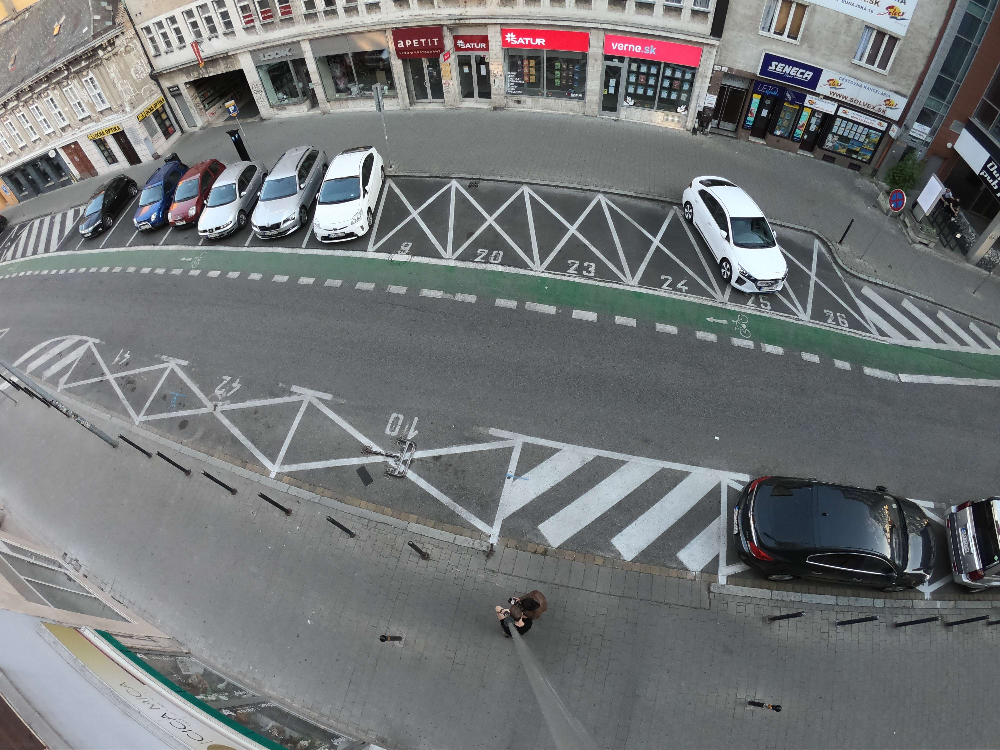

In [ ]:
from PIL import Image
og_test_image = dataset["test"][16]["image"]
og_test_image

In [ ]:
normalize = transforms.Normalize(mean=ADE_MEAN, std=ADE_STD)

test_image = F.to_tensor(og_test_image)
test_image = F.resize(test_image, (448, 448), interpolation=InterpolationMode.BILINEAR)
pixel_values = normalize(test_image).unsqueeze(0)
print(pixel_values.shape)

In [ ]:
# forward pass
with torch.no_grad():
  outputs = model(pixel_values.to(device))

In [ ]:
upsampled_logits = torch.nn.functional.interpolate(outputs.logits,
                                                   size=og_test_image.size[::-1],
                                                   mode="bilinear", align_corners=False)
predicted_map = upsampled_logits.argmax(dim=1)

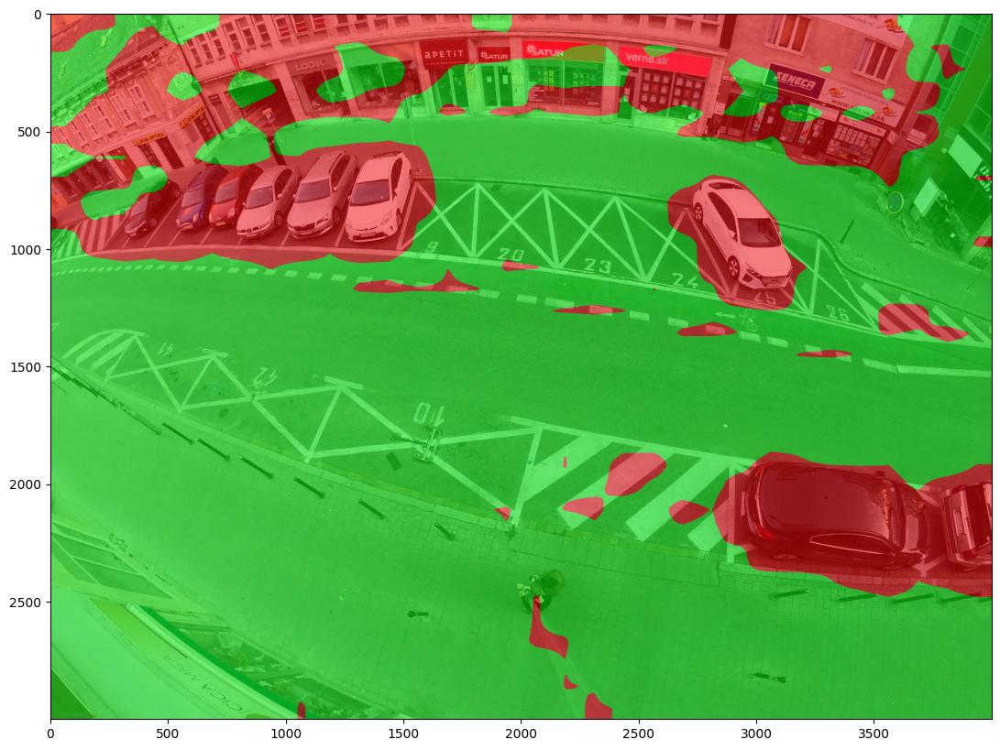

In [ ]:
visualize_map(og_test_image, predicted_map.squeeze().cpu())

In [66]:
torch.save(model, 'model.pt')

In [67]:
model.eval()

all_preds = []
all_labels = []

with torch.no_grad():
    for batch in tqdm(test_dataloader, desc="Testing"):
        pixel_values = batch["pixel_values"].to(device)
        labels = batch["labels"].to(device)

        outputs = model(pixel_values)
        predicted = outputs.logits.argmax(dim=1)

        # Update metric
        metric.add_batch(
            predictions=predicted.cpu().numpy(),
            references=labels.cpu().numpy()
        )

        # Store for F1 Score
        all_preds.append(predicted.cpu().numpy().flatten())
        all_labels.append(labels.cpu().numpy().flatten())

# Compute metrics
metrics = metric.compute(
    num_labels=len(id2label),
    ignore_index=0,
    reduce_labels=False,
)

flat_preds = np.concatenate(all_preds)
flat_labels = np.concatenate(all_labels)
f1 = f1_score(flat_labels, flat_preds, average="macro", zero_division=0)
recall = recall_score(flat_labels, flat_preds, average="macro", zero_division=0)
precision=precision_score(flat_labels, flat_preds, average="macro", zero_division=0)

# Print results
print("\nTest Results:")
print("Mean IoU:", metrics["mean_iou"])
print("Mean Accuracy:", metrics["mean_accuracy"])
print("F1 Score:", f1)
print("Recall:", recall)
print("Precision:", precision)

Testing:   0%|          | 0/11 [00:00<?, ?it/s]

Testing: 100%|██████████| 11/11 [01:27<00:00,  7.98s/it]
C:\Users\Raiden\.cache\huggingface\modules\evaluate_modules\metrics\evaluate-metric--mean_iou\9e450724f21f05592bfb0255fe2fa576df8171fa060d11121d8aecfff0db80d0\mean_iou.py:260: RuntimeWarning: invalid value encountered in divide
  acc = total_area_intersect / total_area_label



Test Results:
Mean IoU: 0.5512402780125306
Mean Accuracy: 0.9044198138856392
F1 Score: 0.28096566802556144
Recall: 0.6044302517198717
Precision: 0.5279581194528304
